In [4]:
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, Subset
from torchvision import transforms
from torchvision.ops import DeformConv2d
from torchmetrics.functional import peak_signal_noise_ratio, structural_similarity_index_measure
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import os
from skimage.feature import canny
import tqdm
from sklearn.model_selection import train_test_split

In [5]:
print("All imports successful!")
print("PyTorch:", torch.__version__)
print("Torchvision:", torchvision.__version__)
print("CUDA:", torch.cuda.is_available())

All imports successful!
PyTorch: 1.12.1+cu113
Torchvision: 0.13.1+cu113
CUDA: True


In [6]:
#2: Edge Map Function
def get_edge_map(image):
    # Handle single ([C, H, W]) or batched ([B, C, H, W]) tensors
    image = image.detach().cpu()
    is_batched = len(image.shape) == 4
    
    if is_batched:
        batch_size = image.shape[0]
        edge_maps = []
        for i in range(batch_size):
            img_np = image[i].numpy().transpose(1, 2, 0)  # [C, H, W] -> [H, W, C]
            img_np = (img_np + 1) / 2  # [-1, 1] to [0, 1]
            edges = canny(img_np.mean(axis=2), sigma=2)
            edge_maps.append(torch.tensor(edges, dtype=torch.float32))
        return torch.stack(edge_maps, dim=0).unsqueeze(1).to(image.device)  # [B, 1, H, W]
    else:
        # Single image case
        img_np = image.numpy().transpose(1, 2, 0)  # [C, H, W] -> [H, W, C]
        img_np = (img_np + 1) / 2  # [-1, 1] to [0, 1]
        edges = canny(img_np.mean(axis=2), sigma=2)
        return torch.tensor(edges, dtype=torch.float32).unsqueeze(0).to(image.device)  # [1, H, W]

In [7]:
class EnhancedGenerator(nn.Module):
    def __init__(self):
        super().__init__()
        # Encoder: Downsample to 64x64
        self.enc1 = nn.Conv2d(4, 64, 4, 2, 1)  # 256x256 -> 128x128
        self.enc2 = DeformableBlock(64, 128)    # 128x128
        self.enc3 = nn.Conv2d(128, 256, 4, 2, 1)  # 128x128 -> 64x64
        
        # Residual blocks at bottleneck
        self.res_blocks = nn.ModuleList([ResidualBlock(256) for _ in range(6)])
        self.attn = AttentionModule(256)
        
        # Decoder: Upsample back to 256x256
        self.dec3 = nn.ConvTranspose2d(256, 128, 4, 2, 1)  # 64x64 -> 128x128
        self.dec2 = DeformableBlock(128, 64)               # 128x128
        self.dec1 = nn.ConvTranspose2d(64, 3, 4, 2, 1)    # 128x128 -> 256x256
        
        self.tanh = nn.Tanh()
    
    def forward(self, x):
        e1 = F.leaky_relu(self.enc1(x), 0.2)
        e2 = self.enc2(e1)
        e3 = F.leaky_relu(self.enc3(e2), 0.2)
        
        r = e3
        for block in self.res_blocks:
            r = block(r)
        r = self.attn(r)
        
        d3 = F.leaky_relu(self.dec3(r), 0.2)
        d2 = self.dec2(d3)
        d1 = self.dec1(d2)
        
        return self.tanh(d1)

In [8]:
class DeformableBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.offset_conv = nn.Conv2d(in_channels, 2 * 3 * 3, 3, padding=1)
        self.deform_conv = DeformConv2d(in_channels, out_channels, 3, padding=1)
        self.norm = nn.GroupNorm(16, out_channels)
        self.relu = nn.LeakyReLU(0.2, inplace=True)
    
    def forward(self, x):
        offset = self.offset_conv(x)
        x = self.deform_conv(x, offset)
        x = self.norm(x)
        x = self.relu(x)
        return x

In [9]:
#4: Multi-Scale Discriminator
class MultiScaleDiscriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.scale1 = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1), nn.GroupNorm(16, 128), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 1, 4, 1, 0), nn.Sigmoid()
        )
        self.scale2 = nn.Sequential(
            nn.AvgPool2d(2),
            nn.Conv2d(3, 64, 4, 2, 1), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1), nn.GroupNorm(16, 128), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 1, 4, 1, 0), nn.Sigmoid()
        )
    
    def forward(self, x):
        return [self.scale1(x), self.scale2(x)]

In [10]:
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.conv1 = nn.Conv2d(channels, channels, 3, padding=1)
        self.norm1 = nn.GroupNorm(16, channels)
        self.conv2 = nn.Conv2d(channels, channels, 3, padding=1)
        self.norm2 = nn.GroupNorm(16, channels)
    
    def forward(self, x):
        residual = x
        x = F.leaky_relu(self.norm1(self.conv1(x)), 0.2)
        x = self.norm2(self.conv2(x))
        return x + residual

class AttentionModule(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.conv = nn.Conv2d(channels, channels, 1)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, x):
        attn = self.sigmoid(self.conv(x))
        return x * attn

In [11]:
#5: Loss Functions
def compute_content_loss(fake, real):
    return F.l1_loss(fake, real)

def compute_adversarial_loss(discriminator, fake, real):
    real_out = discriminator(real)
    fake_out = discriminator(fake)
    loss = 0
    for ro, fo in zip(real_out, fake_out):
        loss += nn.BCELoss()(ro, torch.ones_like(ro)) + nn.BCELoss()(fo, torch.zeros_like(fo))
    return loss / 2

def compute_perceptual_loss(fake, real):
    return F.mse_loss(fake, real)  # Simplified; use VGG if desired

def compute_edge_loss(fake, real):
    fake_edges = get_edge_map(fake)
    real_edges = get_edge_map(real)
    return F.l1_loss(fake_edges, real_edges)

def compute_total_loss(generator, discriminator, fake, real):
    c_loss = compute_content_loss(fake, real)
    a_loss = compute_adversarial_loss(discriminator, fake, real)
    p_loss = compute_perceptual_loss(fake, real)
    e_loss = compute_edge_loss(fake, real)
    lambda1, lambda2, lambda3, lambda4 = 1.0, 3.0, 0.01, 0.1
    total_loss = (lambda1 * c_loss + lambda2 * a_loss + lambda3 * p_loss + lambda4 * e_loss)
    return total_loss, c_loss, a_loss, p_loss, e_loss

In [12]:
class UIEDDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.distorted_images = []
        self.gt_images = []
        
        # Assuming UIED has a structure where distorted and GT images are in separate folders
        # at the root level, with matching filenames
        distorted_dir = os.path.join(root_dir, 'raw')
        gt_dir = os.path.join(root_dir, 'reference')
        
        if os.path.isdir(distorted_dir) and os.path.isdir(gt_dir):
            distorted_files = sorted(os.listdir(distorted_dir))
            gt_files = sorted(os.listdir(gt_dir))
            
            # Verify that for each distorted image there's a corresponding GT image
            # (assuming same filenames or some naming pattern)
            assert len(distorted_files) == len(gt_files), "Mismatch in image counts"
            
            self.distorted_images.extend(os.path.join(distorted_dir, f) for f in distorted_files)
            self.gt_images.extend(os.path.join(gt_dir, f) for f in gt_files)
        
        assert len(self.distorted_images) == len(self.gt_images), "Total mismatch"
        print(f"Total images loaded: {len(self.distorted_images)}")
    
    def __len__(self):
        return len(self.distorted_images)
    
    def __getitem__(self, idx):
        distorted = Image.open(self.distorted_images[idx]).convert('RGB')
        gt = Image.open(self.gt_images[idx]).convert('RGB')
        
        if self.transform:
            distorted = self.transform(distorted)
            gt = self.transform(gt)
            
        edge_map = get_edge_map(distorted).to(distorted.device)
        distorted = torch.cat([distorted, edge_map], dim=0)  # [4, 256, 256]
        return distorted, gt

# Same transform as before
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Load UIED dataset - adjust the path accordingly
dataset = UIEDDataset(
    r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB',
    transform=transform
)
train_loader = DataLoader(dataset, batch_size=4, shuffle=True)

Total images loaded: 890


In [13]:
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

full_dataset = UIEDDataset(
    r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB',
    transform=transform
)

# Split indices
indices = list(range(len(full_dataset)))
train_indices, test_indices = train_test_split(indices, test_size=0.2, random_state=42)

# Create subsets
train_dataset = Subset(full_dataset, train_indices)
test_dataset = Subset(full_dataset, test_indices)

# Create dataloaders
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False)

print(f"Training samples: {len(train_dataset)}, Test samples: {len(test_dataset)}")

Total images loaded: 890
Training samples: 712, Test samples: 178


In [14]:
import torch
import torch.optim as optim
from torch.utils.data import DataLoader
from tqdm import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = EnhancedGenerator().to(device)
discriminator = MultiScaleDiscriminator().to(device)

g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.00002, betas=(0.5, 0.999))

In [17]:
import csv
from datetime import datetime
import os

# Create CSV file and write header
def init_csv_logger(filename='training_log.csv'):
    if not os.path.exists(filename):
        with open(filename, 'w', newline='') as f:
            writer = csv.writer(f)
            writer.writerow([
                'timestamp', 'epoch', 
                'train_g_loss', 'train_d_loss', 
                'test_psnr', 'test_ssim',
                'best_psnr'
            ])

# Function to append data to CSV
def log_epoch_data(filename, data):
    with open(filename, 'a', newline='') as f:
        writer = csv.writer(f)
        writer.writerow(data)

# Initialize CSV logger
log_file = 'training_log.csv'
init_csv_logger(log_file)

num_epochs = 1000
best_psnr = 0
history = {'train': [], 'test': []}

for epoch in range(num_epochs):
    # Training phase
    generator.train()
    discriminator.train()
    epoch_g_loss, epoch_d_loss = 0, 0
    
    train_loader_tqdm = tqdm(train_loader, desc=f"Train Epoch [{epoch+1}/{num_epochs}]")
    
    for i, (distorted, ground_truth) in enumerate(train_loader_tqdm):
        distorted, ground_truth = distorted.to(device), ground_truth.to(device)
        
        # Train Discriminator (every 25 batches)
        if i % 25 == 0:
            d_optimizer.zero_grad()
            with torch.no_grad():
                fake = generator(distorted)
            real_noise = ground_truth + torch.randn_like(ground_truth) * 0.1
            fake_noise = fake.detach() + torch.randn_like(fake) * 0.1
            d_loss = compute_adversarial_loss(discriminator, fake_noise, real_noise)
            d_loss.backward()
            torch.nn.utils.clip_grad_norm_(discriminator.parameters(), max_norm=1.0)
            d_optimizer.step()
            epoch_d_loss += d_loss.item()
        
        # Train Generator (every batch)
        g_optimizer.zero_grad()
        fake = generator(distorted)
        g_loss, c_loss, a_loss, p_loss, e_loss = compute_total_loss(generator, discriminator, fake, ground_truth)
        g_loss.backward()
        torch.nn.utils.clip_grad_norm_(generator.parameters(), max_norm=1.0)
        g_optimizer.step()
        epoch_g_loss += g_loss.item()
        
        # Log metrics (every 10 batches)
        if i % 10 == 0:
            with torch.no_grad():
                psnr = peak_signal_noise_ratio(fake, ground_truth, data_range=2.0).item()
                ssim = structural_similarity_index_measure(fake, ground_truth, data_range=2.0).item()
            train_loader_tqdm.set_postfix({
                'D Loss': f'{d_loss.item():.4f}',
                'G Loss': f'{g_loss.item():.4f}',
                'PSNR': f'{psnr:.2f}',
                'SSIM': f'{ssim:.4f}'
            })
    
    # Evaluation phase
    generator.eval()
    discriminator.eval()
    test_psnr, test_ssim = [], []
    
    with torch.no_grad():
        for distorted, ground_truth in test_loader:
            distorted, ground_truth = distorted.to(device), ground_truth.to(device)
            fake = generator(distorted)
            
            test_psnr.append(peak_signal_noise_ratio(fake, ground_truth, data_range=2.0).item())
            test_ssim.append(structural_similarity_index_measure(fake, ground_truth, data_range=2.0).item())
    
    mean_psnr = np.mean(test_psnr)
    mean_ssim = np.mean(test_ssim)
    
    # Save best model
    if mean_psnr > best_psnr:
        best_psnr = mean_psnr
        torch.save(generator.state_dict(), "generator_best.pth")
        torch.save(discriminator.state_dict(), "discriminator_best.pth")
    
    # Log epoch data to CSV
    log_data = [
        datetime.now().strftime("%Y-%m-%d %H:%M:%S"),
        epoch + 1,
        epoch_g_loss / len(train_loader),
        epoch_d_loss / max(1, len(train_loader) // 25),
        mean_psnr,
        mean_ssim,
        best_psnr
    ]
    log_epoch_data(log_file, log_data)  # Save metrics for this epoch
    
    print(f"Epoch {epoch+1}: Test PSNR: {mean_psnr:.2f}, SSIM: {mean_ssim:.4f}")

Train Epoch [1/1000]: 100%|███| 178/178 [01:18<00:00,  2.27it/s, D Loss=0.0038, G Loss=0.0915, PSNR=24.53, SSIM=0.6258]


Epoch 1: Test PSNR: 20.81, SSIM: 0.5642


Train Epoch [2/1000]: 100%|███| 178/178 [01:17<00:00,  2.29it/s, D Loss=0.0038, G Loss=0.0740, PSNR=26.20, SSIM=0.7035]


Epoch 2: Test PSNR: 21.13, SSIM: 0.5808


Train Epoch [3/1000]: 100%|███| 178/178 [01:17<00:00,  2.31it/s, D Loss=0.0031, G Loss=0.1089, PSNR=23.79, SSIM=0.6539]


Epoch 3: Test PSNR: 20.87, SSIM: 0.5679


Train Epoch [4/1000]: 100%|███| 178/178 [01:17<00:00,  2.30it/s, D Loss=0.0040, G Loss=0.1090, PSNR=23.16, SSIM=0.6809]


Epoch 4: Test PSNR: 21.15, SSIM: 0.5841


Train Epoch [5/1000]: 100%|███| 178/178 [01:18<00:00,  2.28it/s, D Loss=0.0037, G Loss=0.1015, PSNR=23.53, SSIM=0.6592]


Epoch 5: Test PSNR: 21.14, SSIM: 0.5802


Train Epoch [6/1000]: 100%|███| 178/178 [01:20<00:00,  2.21it/s, D Loss=0.0039, G Loss=0.0957, PSNR=24.52, SSIM=0.6780]


Epoch 6: Test PSNR: 21.15, SSIM: 0.5868


Train Epoch [7/1000]: 100%|███| 178/178 [01:22<00:00,  2.17it/s, D Loss=0.0029, G Loss=0.0825, PSNR=25.82, SSIM=0.7073]


Epoch 7: Test PSNR: 21.16, SSIM: 0.5821


Train Epoch [8/1000]: 100%|███| 178/178 [01:22<00:00,  2.16it/s, D Loss=0.0053, G Loss=0.0793, PSNR=25.67, SSIM=0.7208]


Epoch 8: Test PSNR: 21.08, SSIM: 0.5897


Train Epoch [9/1000]: 100%|███| 178/178 [01:22<00:00,  2.16it/s, D Loss=0.0057, G Loss=0.1054, PSNR=23.55, SSIM=0.6886]


Epoch 9: Test PSNR: 21.20, SSIM: 0.5946


Train Epoch [10/1000]: 100%|██| 178/178 [01:21<00:00,  2.18it/s, D Loss=0.0042, G Loss=0.0684, PSNR=26.68, SSIM=0.7264]


Epoch 10: Test PSNR: 21.08, SSIM: 0.5871


Train Epoch [11/1000]: 100%|██| 178/178 [01:21<00:00,  2.18it/s, D Loss=0.0028, G Loss=0.0970, PSNR=24.34, SSIM=0.6876]


Epoch 11: Test PSNR: 20.92, SSIM: 0.5855


Train Epoch [12/1000]: 100%|██| 178/178 [01:21<00:00,  2.18it/s, D Loss=0.0037, G Loss=0.1017, PSNR=24.10, SSIM=0.6751]


Epoch 12: Test PSNR: 21.18, SSIM: 0.5856


Train Epoch [13/1000]: 100%|██| 178/178 [01:21<00:00,  2.18it/s, D Loss=0.0029, G Loss=0.0729, PSNR=25.63, SSIM=0.6909]


Epoch 13: Test PSNR: 21.30, SSIM: 0.5945


Train Epoch [14/1000]: 100%|██| 178/178 [01:22<00:00,  2.16it/s, D Loss=0.0042, G Loss=0.0871, PSNR=24.87, SSIM=0.6936]


Epoch 14: Test PSNR: 21.20, SSIM: 0.5939


Train Epoch [15/1000]: 100%|██| 178/178 [01:21<00:00,  2.18it/s, D Loss=0.0027, G Loss=0.0812, PSNR=25.97, SSIM=0.7147]


Epoch 15: Test PSNR: 21.25, SSIM: 0.6034


Train Epoch [16/1000]: 100%|██| 178/178 [01:21<00:00,  2.17it/s, D Loss=0.0037, G Loss=0.0760, PSNR=26.59, SSIM=0.7606]


Epoch 16: Test PSNR: 21.25, SSIM: 0.6044


Train Epoch [17/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0039, G Loss=0.0754, PSNR=26.09, SSIM=0.7335]


Epoch 17: Test PSNR: 21.37, SSIM: 0.6042


Train Epoch [18/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0047, G Loss=0.1021, PSNR=24.06, SSIM=0.6835]


Epoch 18: Test PSNR: 21.34, SSIM: 0.6120


Train Epoch [19/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0041, G Loss=0.0748, PSNR=26.81, SSIM=0.7702]


Epoch 19: Test PSNR: 21.41, SSIM: 0.6105


Train Epoch [20/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0036, G Loss=0.0782, PSNR=26.22, SSIM=0.7198]


Epoch 20: Test PSNR: 21.13, SSIM: 0.5921


Train Epoch [21/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0037, G Loss=0.0913, PSNR=24.45, SSIM=0.6963]


Epoch 21: Test PSNR: 21.37, SSIM: 0.6066


Train Epoch [22/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0036, G Loss=0.0976, PSNR=24.31, SSIM=0.7081]


Epoch 22: Test PSNR: 21.22, SSIM: 0.6072


Train Epoch [23/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0045, G Loss=0.0943, PSNR=24.31, SSIM=0.6860]


Epoch 23: Test PSNR: 21.44, SSIM: 0.6153


Train Epoch [24/1000]: 100%|██| 178/178 [01:22<00:00,  2.17it/s, D Loss=0.0031, G Loss=0.0846, PSNR=25.60, SSIM=0.7104]


Epoch 24: Test PSNR: 21.37, SSIM: 0.6148


Train Epoch [25/1000]: 100%|██| 178/178 [01:22<00:00,  2.17it/s, D Loss=0.0029, G Loss=0.0921, PSNR=24.68, SSIM=0.7303]


Epoch 25: Test PSNR: 21.27, SSIM: 0.6056


Train Epoch [26/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0031, G Loss=0.0857, PSNR=24.94, SSIM=0.7199]


Epoch 26: Test PSNR: 21.44, SSIM: 0.6142


Train Epoch [27/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0033, G Loss=0.0997, PSNR=24.36, SSIM=0.7229]


Epoch 27: Test PSNR: 21.28, SSIM: 0.6025


Train Epoch [28/1000]: 100%|██| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0035, G Loss=0.0762, PSNR=26.57, SSIM=0.7230]


Epoch 28: Test PSNR: 21.38, SSIM: 0.6206


Train Epoch [29/1000]: 100%|██| 178/178 [01:25<00:00,  2.09it/s, D Loss=0.0034, G Loss=0.0619, PSNR=27.84, SSIM=0.7588]


Epoch 29: Test PSNR: 21.29, SSIM: 0.6103


Train Epoch [30/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0041, G Loss=0.0839, PSNR=25.50, SSIM=0.7148]


Epoch 30: Test PSNR: 21.26, SSIM: 0.6169


Train Epoch [31/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0035, G Loss=0.0780, PSNR=26.51, SSIM=0.7747]


Epoch 31: Test PSNR: 21.62, SSIM: 0.6324


Train Epoch [32/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0045, G Loss=0.0808, PSNR=26.56, SSIM=0.7251]


Epoch 32: Test PSNR: 21.29, SSIM: 0.6242


Train Epoch [33/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0066, G Loss=0.0881, PSNR=25.50, SSIM=0.7334]


Epoch 33: Test PSNR: 21.57, SSIM: 0.6261


Train Epoch [34/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0046, G Loss=0.0613, PSNR=28.19, SSIM=0.7775]


Epoch 34: Test PSNR: 21.38, SSIM: 0.6279


Train Epoch [35/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0109, G Loss=0.0868, PSNR=25.51, SSIM=0.7356]


Epoch 35: Test PSNR: 21.50, SSIM: 0.6303


Train Epoch [36/1000]: 100%|██| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0031, G Loss=0.0718, PSNR=26.73, SSIM=0.7232]


Epoch 36: Test PSNR: 21.29, SSIM: 0.6134


Train Epoch [37/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0073, G Loss=0.0610, PSNR=28.31, SSIM=0.7956]


Epoch 37: Test PSNR: 21.40, SSIM: 0.6252


Train Epoch [38/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0030, G Loss=0.0714, PSNR=27.03, SSIM=0.7724]


Epoch 38: Test PSNR: 21.61, SSIM: 0.6383


Train Epoch [39/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0034, G Loss=0.0909, PSNR=25.09, SSIM=0.7139]


Epoch 39: Test PSNR: 21.55, SSIM: 0.6388


Train Epoch [40/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0033, G Loss=0.1146, PSNR=22.95, SSIM=0.6695]


Epoch 40: Test PSNR: 21.54, SSIM: 0.6338


Train Epoch [41/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0042, G Loss=0.0758, PSNR=26.53, SSIM=0.7671]


Epoch 41: Test PSNR: 21.51, SSIM: 0.6376


Train Epoch [42/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0039, G Loss=0.0630, PSNR=28.16, SSIM=0.7826]


Epoch 42: Test PSNR: 21.57, SSIM: 0.6411


Train Epoch [43/1000]: 100%|██| 178/178 [01:22<00:00,  2.16it/s, D Loss=0.0037, G Loss=0.0703, PSNR=26.94, SSIM=0.7766]


Epoch 43: Test PSNR: 21.35, SSIM: 0.6352


Train Epoch [44/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0027, G Loss=0.0898, PSNR=25.21, SSIM=0.7264]


Epoch 44: Test PSNR: 21.62, SSIM: 0.6379


Train Epoch [45/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0029, G Loss=0.0827, PSNR=25.88, SSIM=0.7244]


Epoch 45: Test PSNR: 21.51, SSIM: 0.6444


Train Epoch [46/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0036, G Loss=0.0657, PSNR=27.28, SSIM=0.7336]


Epoch 46: Test PSNR: 21.46, SSIM: 0.6313


Train Epoch [47/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0075, G Loss=0.0825, PSNR=25.72, SSIM=0.7342]


Epoch 47: Test PSNR: 21.46, SSIM: 0.6301


Train Epoch [48/1000]: 100%|██| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0048, G Loss=0.0648, PSNR=27.50, SSIM=0.8056]


Epoch 48: Test PSNR: 21.55, SSIM: 0.6365


Train Epoch [49/1000]: 100%|██| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0022, G Loss=0.1009, PSNR=23.88, SSIM=0.6855]


Epoch 49: Test PSNR: 21.49, SSIM: 0.6383


Train Epoch [50/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0036, G Loss=0.0681, PSNR=27.83, SSIM=0.7765]


Epoch 50: Test PSNR: 21.51, SSIM: 0.6405


Train Epoch [51/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0027, G Loss=0.0767, PSNR=26.61, SSIM=0.7880]


Epoch 51: Test PSNR: 21.67, SSIM: 0.6415


Train Epoch [52/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0036, G Loss=0.0893, PSNR=25.64, SSIM=0.7693]


Epoch 52: Test PSNR: 21.55, SSIM: 0.6503


Train Epoch [53/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0028, G Loss=0.0703, PSNR=26.89, SSIM=0.7503]


Epoch 53: Test PSNR: 21.46, SSIM: 0.6409


Train Epoch [54/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0034, G Loss=0.0863, PSNR=25.58, SSIM=0.7750]


Epoch 54: Test PSNR: 21.63, SSIM: 0.6495


Train Epoch [55/1000]: 100%|██| 178/178 [01:22<00:00,  2.14it/s, D Loss=0.0066, G Loss=0.0469, PSNR=30.66, SSIM=0.8055]


Epoch 55: Test PSNR: 21.67, SSIM: 0.6580


Train Epoch [56/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0057, G Loss=0.0868, PSNR=25.43, SSIM=0.7517]


Epoch 56: Test PSNR: 21.63, SSIM: 0.6548


Train Epoch [57/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0037, G Loss=0.0520, PSNR=29.61, SSIM=0.8187]


Epoch 57: Test PSNR: 21.63, SSIM: 0.6543


Train Epoch [58/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0075, G Loss=0.0512, PSNR=29.74, SSIM=0.8047]


Epoch 58: Test PSNR: 21.73, SSIM: 0.6607


Train Epoch [59/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0084, G Loss=0.0754, PSNR=27.02, SSIM=0.8208]


Epoch 59: Test PSNR: 21.78, SSIM: 0.6627


Train Epoch [60/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0053, G Loss=0.0905, PSNR=25.40, SSIM=0.7774]


Epoch 60: Test PSNR: 21.54, SSIM: 0.6546


Train Epoch [61/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0034, G Loss=0.0724, PSNR=25.37, SSIM=0.7642]


Epoch 61: Test PSNR: 21.63, SSIM: 0.6442


Train Epoch [62/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0034, G Loss=0.0560, PSNR=29.09, SSIM=0.7941]


Epoch 62: Test PSNR: 21.60, SSIM: 0.6517


Train Epoch [63/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0040, G Loss=0.0693, PSNR=26.99, SSIM=0.8108]


Epoch 63: Test PSNR: 21.83, SSIM: 0.6635


Train Epoch [64/1000]: 100%|██| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0040, G Loss=0.0635, PSNR=27.96, SSIM=0.7919]


Epoch 64: Test PSNR: 21.69, SSIM: 0.6580


Train Epoch [65/1000]: 100%|██| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0052, G Loss=0.0740, PSNR=26.99, SSIM=0.7560]


Epoch 65: Test PSNR: 21.60, SSIM: 0.6588


Train Epoch [66/1000]: 100%|██| 178/178 [01:26<00:00,  2.07it/s, D Loss=0.0039, G Loss=0.0656, PSNR=27.57, SSIM=0.7922]


Epoch 66: Test PSNR: 21.65, SSIM: 0.6550


Train Epoch [67/1000]: 100%|██| 178/178 [01:26<00:00,  2.06it/s, D Loss=0.0065, G Loss=0.0579, PSNR=28.32, SSIM=0.8048]


Epoch 67: Test PSNR: 21.66, SSIM: 0.6519


Train Epoch [68/1000]: 100%|██| 178/178 [01:25<00:00,  2.08it/s, D Loss=0.0049, G Loss=0.0749, PSNR=26.12, SSIM=0.7453]


Epoch 68: Test PSNR: 21.65, SSIM: 0.6630


Train Epoch [69/1000]: 100%|██| 178/178 [01:26<00:00,  2.07it/s, D Loss=0.0029, G Loss=0.0602, PSNR=28.58, SSIM=0.8194]


Epoch 69: Test PSNR: 21.73, SSIM: 0.6499


Train Epoch [70/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0046, G Loss=0.0695, PSNR=27.05, SSIM=0.8157]


Epoch 70: Test PSNR: 21.80, SSIM: 0.6707


Train Epoch [71/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0053, G Loss=0.0734, PSNR=26.30, SSIM=0.7983]


Epoch 71: Test PSNR: 21.63, SSIM: 0.6701


Train Epoch [72/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0082, G Loss=0.0554, PSNR=28.86, SSIM=0.8425]


Epoch 72: Test PSNR: 21.71, SSIM: 0.6628


Train Epoch [73/1000]: 100%|██| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0056, G Loss=0.0533, PSNR=29.75, SSIM=0.8511]


Epoch 73: Test PSNR: 21.55, SSIM: 0.6634


Train Epoch [74/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0066, G Loss=0.0975, PSNR=24.81, SSIM=0.7727]


Epoch 74: Test PSNR: 21.74, SSIM: 0.6734


Train Epoch [75/1000]: 100%|██| 178/178 [01:25<00:00,  2.09it/s, D Loss=0.0078, G Loss=0.0719, PSNR=27.27, SSIM=0.7933]


Epoch 75: Test PSNR: 21.87, SSIM: 0.6747


Train Epoch [76/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0091, G Loss=0.0605, PSNR=28.90, SSIM=0.8394]


Epoch 76: Test PSNR: 21.79, SSIM: 0.6658


Train Epoch [77/1000]: 100%|██| 178/178 [01:25<00:00,  2.09it/s, D Loss=0.0088, G Loss=0.0544, PSNR=29.73, SSIM=0.8419]


Epoch 77: Test PSNR: 21.77, SSIM: 0.6693


Train Epoch [78/1000]: 100%|██| 178/178 [01:25<00:00,  2.09it/s, D Loss=0.0083, G Loss=0.0585, PSNR=29.78, SSIM=0.8342]


Epoch 78: Test PSNR: 21.70, SSIM: 0.6659


Train Epoch [79/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0154, G Loss=0.0629, PSNR=28.77, SSIM=0.8373]


Epoch 79: Test PSNR: 21.54, SSIM: 0.6637


Train Epoch [80/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0054, G Loss=0.0577, PSNR=28.67, SSIM=0.8291]


Epoch 80: Test PSNR: 21.76, SSIM: 0.6728


Train Epoch [81/1000]: 100%|██| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0057, G Loss=0.1000, PSNR=27.50, SSIM=0.8312]


Epoch 81: Test PSNR: 21.77, SSIM: 0.6688


Train Epoch [82/1000]: 100%|██| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0080, G Loss=0.0651, PSNR=27.76, SSIM=0.7911]


Epoch 82: Test PSNR: 21.80, SSIM: 0.6758


Train Epoch [83/1000]: 100%|██| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0073, G Loss=0.0496, PSNR=30.33, SSIM=0.8744]


Epoch 83: Test PSNR: 21.69, SSIM: 0.6711


Train Epoch [84/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0055, G Loss=0.0702, PSNR=26.38, SSIM=0.7861]


Epoch 84: Test PSNR: 21.69, SSIM: 0.6746


Train Epoch [85/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0095, G Loss=0.0652, PSNR=28.41, SSIM=0.8482]


Epoch 85: Test PSNR: 21.81, SSIM: 0.6835


Train Epoch [86/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0095, G Loss=0.0541, PSNR=29.34, SSIM=0.8478]


Epoch 86: Test PSNR: 21.77, SSIM: 0.6744


Train Epoch [87/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0055, G Loss=0.0808, PSNR=26.23, SSIM=0.7852]


Epoch 87: Test PSNR: 21.79, SSIM: 0.6754


Train Epoch [88/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0063, G Loss=0.0613, PSNR=27.90, SSIM=0.8411]


Epoch 88: Test PSNR: 21.75, SSIM: 0.6778


Train Epoch [89/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0078, G Loss=0.0528, PSNR=29.19, SSIM=0.8056]


Epoch 89: Test PSNR: 21.97, SSIM: 0.6865


Train Epoch [90/1000]: 100%|██| 178/178 [01:22<00:00,  2.15it/s, D Loss=0.0063, G Loss=0.0492, PSNR=30.58, SSIM=0.8243]


Epoch 90: Test PSNR: 21.83, SSIM: 0.6767


Train Epoch [91/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0074, G Loss=0.0480, PSNR=29.82, SSIM=0.8707]


Epoch 91: Test PSNR: 21.78, SSIM: 0.6798


Train Epoch [92/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0097, G Loss=0.0710, PSNR=27.38, SSIM=0.8205]


Epoch 92: Test PSNR: 21.79, SSIM: 0.6802


Train Epoch [93/1000]: 100%|██| 178/178 [01:23<00:00,  2.12it/s, D Loss=0.0037, G Loss=0.0662, PSNR=27.92, SSIM=0.8489]


Epoch 93: Test PSNR: 21.81, SSIM: 0.6783


Train Epoch [94/1000]: 100%|██| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0101, G Loss=0.0682, PSNR=27.51, SSIM=0.7690]


Epoch 94: Test PSNR: 21.58, SSIM: 0.6677


Train Epoch [95/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0144, G Loss=0.0657, PSNR=27.16, SSIM=0.8051]


Epoch 95: Test PSNR: 21.94, SSIM: 0.6840


Train Epoch [96/1000]: 100%|██| 178/178 [01:25<00:00,  2.09it/s, D Loss=0.0113, G Loss=0.0704, PSNR=27.44, SSIM=0.7918]


Epoch 96: Test PSNR: 21.76, SSIM: 0.6792


Train Epoch [97/1000]: 100%|██| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0078, G Loss=0.0527, PSNR=29.69, SSIM=0.8358]


Epoch 97: Test PSNR: 21.81, SSIM: 0.6758


Train Epoch [98/1000]: 100%|██| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0135, G Loss=0.0688, PSNR=28.18, SSIM=0.8017]


Epoch 98: Test PSNR: 21.80, SSIM: 0.6815


Train Epoch [99/1000]: 100%|██| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0105, G Loss=0.0581, PSNR=28.89, SSIM=0.8338]


Epoch 99: Test PSNR: 21.77, SSIM: 0.6800


Train Epoch [100/1000]: 100%|█| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0110, G Loss=0.0618, PSNR=28.46, SSIM=0.8424]


Epoch 100: Test PSNR: 21.86, SSIM: 0.6857


Train Epoch [101/1000]: 100%|█| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0076, G Loss=0.0535, PSNR=30.01, SSIM=0.8662]


Epoch 101: Test PSNR: 21.72, SSIM: 0.6805


Train Epoch [102/1000]: 100%|█| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0154, G Loss=0.0493, PSNR=30.90, SSIM=0.8780]


Epoch 102: Test PSNR: 21.81, SSIM: 0.6861


Train Epoch [103/1000]: 100%|█| 178/178 [01:24<00:00,  2.09it/s, D Loss=0.0087, G Loss=0.0659, PSNR=27.98, SSIM=0.8300]


Epoch 103: Test PSNR: 21.86, SSIM: 0.6853


Train Epoch [104/1000]: 100%|█| 178/178 [01:25<00:00,  2.07it/s, D Loss=0.0143, G Loss=0.0674, PSNR=27.95, SSIM=0.8419]


Epoch 104: Test PSNR: 21.78, SSIM: 0.6873


Train Epoch [105/1000]: 100%|█| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0051, G Loss=0.0666, PSNR=28.89, SSIM=0.8757]


Epoch 105: Test PSNR: 21.81, SSIM: 0.6857


Train Epoch [106/1000]: 100%|█| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0221, G Loss=0.0743, PSNR=26.55, SSIM=0.8105]


Epoch 106: Test PSNR: 21.87, SSIM: 0.6906


Train Epoch [107/1000]: 100%|█| 178/178 [01:23<00:00,  2.14it/s, D Loss=0.0072, G Loss=0.0581, PSNR=29.17, SSIM=0.8444]


Epoch 107: Test PSNR: 21.73, SSIM: 0.6803


Train Epoch [108/1000]: 100%|█| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0090, G Loss=0.0630, PSNR=27.65, SSIM=0.8445]


Epoch 108: Test PSNR: 21.87, SSIM: 0.6890


Train Epoch [109/1000]: 100%|█| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0087, G Loss=0.0660, PSNR=28.57, SSIM=0.8373]


Epoch 109: Test PSNR: 21.88, SSIM: 0.6927


Train Epoch [110/1000]: 100%|█| 178/178 [01:25<00:00,  2.09it/s, D Loss=0.0059, G Loss=0.0599, PSNR=28.54, SSIM=0.8408]


Epoch 110: Test PSNR: 21.73, SSIM: 0.6796


Train Epoch [111/1000]: 100%|█| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0112, G Loss=0.0666, PSNR=27.59, SSIM=0.7933]


Epoch 111: Test PSNR: 21.77, SSIM: 0.6781


Train Epoch [112/1000]: 100%|█| 178/178 [01:26<00:00,  2.06it/s, D Loss=0.0032, G Loss=0.0528, PSNR=29.13, SSIM=0.8243]


Epoch 112: Test PSNR: 21.76, SSIM: 0.6742


Train Epoch [113/1000]: 100%|█| 178/178 [01:25<00:00,  2.08it/s, D Loss=0.0049, G Loss=0.0591, PSNR=28.67, SSIM=0.8299]


Epoch 113: Test PSNR: 21.83, SSIM: 0.6841


Train Epoch [114/1000]: 100%|█| 178/178 [01:25<00:00,  2.08it/s, D Loss=0.0060, G Loss=0.0538, PSNR=29.32, SSIM=0.8647]


Epoch 114: Test PSNR: 21.96, SSIM: 0.6881


Train Epoch [115/1000]: 100%|█| 178/178 [01:24<00:00,  2.12it/s, D Loss=0.0098, G Loss=0.0583, PSNR=30.07, SSIM=0.8744]


Epoch 115: Test PSNR: 21.86, SSIM: 0.6862


Train Epoch [116/1000]: 100%|█| 178/178 [01:24<00:00,  2.11it/s, D Loss=0.0120, G Loss=0.0748, PSNR=26.82, SSIM=0.8302]


Epoch 116: Test PSNR: 21.85, SSIM: 0.6907


Train Epoch [117/1000]: 100%|█| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0123, G Loss=0.0481, PSNR=30.10, SSIM=0.8519]


Epoch 117: Test PSNR: 21.98, SSIM: 0.6945


Train Epoch [118/1000]: 100%|█| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0063, G Loss=0.0518, PSNR=29.98, SSIM=0.8710]


Epoch 118: Test PSNR: 21.85, SSIM: 0.6862


Train Epoch [119/1000]: 100%|█| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0092, G Loss=0.0633, PSNR=28.57, SSIM=0.8543]


Epoch 119: Test PSNR: 21.81, SSIM: 0.6898


Train Epoch [120/1000]: 100%|█| 178/178 [01:24<00:00,  2.10it/s, D Loss=0.0098, G Loss=0.0487, PSNR=30.33, SSIM=0.8612]


Epoch 120: Test PSNR: 21.90, SSIM: 0.6931


Train Epoch [121/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0102, G Loss=0.0626, PSNR=28.73, SSIM=0.8435]


Epoch 121: Test PSNR: 21.96, SSIM: 0.6990


Train Epoch [122/1000]: 100%|█| 178/178 [01:26<00:00,  2.05it/s, D Loss=0.0169, G Loss=0.0756, PSNR=26.99, SSIM=0.8039]


Epoch 122: Test PSNR: 21.95, SSIM: 0.6955


Train Epoch [123/1000]: 100%|█| 178/178 [01:27<00:00,  2.05it/s, D Loss=0.0103, G Loss=0.0793, PSNR=25.61, SSIM=0.8250]


Epoch 123: Test PSNR: 21.75, SSIM: 0.6922


Train Epoch [124/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0019, G Loss=0.0548, PSNR=29.74, SSIM=0.8800]


Epoch 124: Test PSNR: 21.82, SSIM: 0.6859


Train Epoch [125/1000]: 100%|█| 178/178 [01:26<00:00,  2.06it/s, D Loss=0.0128, G Loss=0.0601, PSNR=28.97, SSIM=0.8742]


Epoch 125: Test PSNR: 21.79, SSIM: 0.6895


Train Epoch [126/1000]: 100%|█| 178/178 [01:26<00:00,  2.05it/s, D Loss=0.0147, G Loss=0.0631, PSNR=28.28, SSIM=0.8253]


Epoch 126: Test PSNR: 21.93, SSIM: 0.6976


Train Epoch [127/1000]: 100%|█| 178/178 [01:25<00:00,  2.08it/s, D Loss=0.0097, G Loss=0.0672, PSNR=27.75, SSIM=0.8314]


Epoch 127: Test PSNR: 21.92, SSIM: 0.6944


Train Epoch [128/1000]: 100%|█| 178/178 [01:26<00:00,  2.05it/s, D Loss=0.0090, G Loss=0.0523, PSNR=29.86, SSIM=0.8548]


Epoch 128: Test PSNR: 22.02, SSIM: 0.7005


Train Epoch [129/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0151, G Loss=0.0473, PSNR=30.63, SSIM=0.8779]


Epoch 129: Test PSNR: 21.79, SSIM: 0.6863


Train Epoch [130/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0114, G Loss=0.0568, PSNR=29.26, SSIM=0.8445]


Epoch 130: Test PSNR: 21.75, SSIM: 0.6859


Train Epoch [131/1000]: 100%|█| 178/178 [01:26<00:00,  2.05it/s, D Loss=0.0056, G Loss=0.0447, PSNR=30.88, SSIM=0.8735]


Epoch 131: Test PSNR: 21.88, SSIM: 0.6849


Train Epoch [132/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0100, G Loss=0.0546, PSNR=28.96, SSIM=0.8560]


Epoch 132: Test PSNR: 21.91, SSIM: 0.6899


Train Epoch [133/1000]: 100%|█| 178/178 [01:26<00:00,  2.05it/s, D Loss=0.0186, G Loss=0.0656, PSNR=28.44, SSIM=0.8442]


Epoch 133: Test PSNR: 21.93, SSIM: 0.6955


Train Epoch [134/1000]: 100%|█| 178/178 [01:26<00:00,  2.05it/s, D Loss=0.0323, G Loss=0.0607, PSNR=28.30, SSIM=0.8547]


Epoch 134: Test PSNR: 21.91, SSIM: 0.6940


Train Epoch [135/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0195, G Loss=0.0549, PSNR=29.42, SSIM=0.8641]


Epoch 135: Test PSNR: 21.90, SSIM: 0.7009


Train Epoch [136/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0081, G Loss=0.0614, PSNR=28.46, SSIM=0.8367]


Epoch 136: Test PSNR: 21.98, SSIM: 0.6994


Train Epoch [137/1000]: 100%|█| 178/178 [01:27<00:00,  2.02it/s, D Loss=0.0118, G Loss=0.0573, PSNR=29.94, SSIM=0.8543]


Epoch 137: Test PSNR: 22.00, SSIM: 0.6959


Train Epoch [138/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0060, G Loss=0.0596, PSNR=28.69, SSIM=0.8159]


Epoch 138: Test PSNR: 21.88, SSIM: 0.6927


Train Epoch [139/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0188, G Loss=0.0835, PSNR=25.27, SSIM=0.7947]


Epoch 139: Test PSNR: 21.90, SSIM: 0.6924


Train Epoch [140/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0118, G Loss=0.0600, PSNR=28.80, SSIM=0.8625]


Epoch 140: Test PSNR: 21.94, SSIM: 0.6999


Train Epoch [141/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0325, G Loss=0.0734, PSNR=27.63, SSIM=0.8016]


Epoch 141: Test PSNR: 21.86, SSIM: 0.7007


Train Epoch [142/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0122, G Loss=0.0694, PSNR=27.21, SSIM=0.7968]


Epoch 142: Test PSNR: 21.70, SSIM: 0.6771


Train Epoch [143/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0181, G Loss=0.0624, PSNR=28.72, SSIM=0.8033]


Epoch 143: Test PSNR: 21.74, SSIM: 0.6889


Train Epoch [144/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0095, G Loss=0.0555, PSNR=29.05, SSIM=0.8610]


Epoch 144: Test PSNR: 21.86, SSIM: 0.6940


Train Epoch [145/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0157, G Loss=0.0544, PSNR=30.07, SSIM=0.8836]


Epoch 145: Test PSNR: 21.98, SSIM: 0.7002


Train Epoch [146/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0141, G Loss=0.0537, PSNR=29.88, SSIM=0.8670]


Epoch 146: Test PSNR: 21.99, SSIM: 0.7016


Train Epoch [147/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0098, G Loss=0.0629, PSNR=28.33, SSIM=0.8446]


Epoch 147: Test PSNR: 21.98, SSIM: 0.6988


Train Epoch [148/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0130, G Loss=0.0486, PSNR=31.34, SSIM=0.8876]


Epoch 148: Test PSNR: 21.95, SSIM: 0.7004


Train Epoch [149/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0133, G Loss=0.0492, PSNR=30.72, SSIM=0.8930]


Epoch 149: Test PSNR: 21.86, SSIM: 0.6994


Train Epoch [150/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0122, G Loss=0.0551, PSNR=29.56, SSIM=0.8449]


Epoch 150: Test PSNR: 22.01, SSIM: 0.7061


Train Epoch [151/1000]: 100%|█| 178/178 [01:27<00:00,  2.02it/s, D Loss=0.0072, G Loss=0.0513, PSNR=29.84, SSIM=0.8526]


Epoch 151: Test PSNR: 21.86, SSIM: 0.6982


Train Epoch [152/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0209, G Loss=0.0634, PSNR=29.58, SSIM=0.8650]


Epoch 152: Test PSNR: 22.13, SSIM: 0.7083


Train Epoch [153/1000]: 100%|█| 178/178 [01:27<00:00,  2.02it/s, D Loss=0.0163, G Loss=0.0534, PSNR=29.48, SSIM=0.8628]


Epoch 153: Test PSNR: 21.90, SSIM: 0.6980


Train Epoch [154/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0114, G Loss=0.0504, PSNR=29.56, SSIM=0.8417]


Epoch 154: Test PSNR: 21.85, SSIM: 0.6985


Train Epoch [155/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0114, G Loss=0.0456, PSNR=31.07, SSIM=0.8674]


Epoch 155: Test PSNR: 21.92, SSIM: 0.7005


Train Epoch [156/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0209, G Loss=0.0616, PSNR=29.00, SSIM=0.8624]


Epoch 156: Test PSNR: 21.83, SSIM: 0.6948


Train Epoch [157/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0109, G Loss=0.0621, PSNR=30.20, SSIM=0.8892]


Epoch 157: Test PSNR: 21.96, SSIM: 0.7070


Train Epoch [158/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0499, G Loss=0.0624, PSNR=29.19, SSIM=0.8574]


Epoch 158: Test PSNR: 21.97, SSIM: 0.7057


Train Epoch [159/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0074, G Loss=0.0502, PSNR=30.37, SSIM=0.8611]


Epoch 159: Test PSNR: 21.88, SSIM: 0.6939


Train Epoch [160/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0083, G Loss=0.0526, PSNR=29.62, SSIM=0.8727]


Epoch 160: Test PSNR: 22.05, SSIM: 0.7047


Train Epoch [161/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0047, G Loss=0.0473, PSNR=29.98, SSIM=0.8910]


Epoch 161: Test PSNR: 21.90, SSIM: 0.6986


Train Epoch [162/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0122, G Loss=0.0590, PSNR=28.33, SSIM=0.8529]


Epoch 162: Test PSNR: 21.81, SSIM: 0.6933


Train Epoch [163/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0240, G Loss=0.0610, PSNR=29.05, SSIM=0.8519]


Epoch 163: Test PSNR: 21.92, SSIM: 0.7049


Train Epoch [164/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0137, G Loss=0.0385, PSNR=32.59, SSIM=0.8995]


Epoch 164: Test PSNR: 21.96, SSIM: 0.7006


Train Epoch [165/1000]: 100%|█| 178/178 [01:30<00:00,  1.98it/s, D Loss=0.0231, G Loss=0.0604, PSNR=29.07, SSIM=0.8649]


Epoch 165: Test PSNR: 21.86, SSIM: 0.7080


Train Epoch [166/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0169, G Loss=0.0608, PSNR=28.76, SSIM=0.8715]


Epoch 166: Test PSNR: 22.01, SSIM: 0.7084


Train Epoch [167/1000]: 100%|█| 178/178 [01:29<00:00,  1.98it/s, D Loss=0.0196, G Loss=0.0590, PSNR=29.06, SSIM=0.8539]


Epoch 167: Test PSNR: 22.01, SSIM: 0.7045


Train Epoch [168/1000]: 100%|█| 178/178 [01:29<00:00,  1.98it/s, D Loss=0.0117, G Loss=0.0598, PSNR=28.79, SSIM=0.8499]


Epoch 168: Test PSNR: 21.82, SSIM: 0.6955


Train Epoch [169/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0091, G Loss=0.0416, PSNR=32.00, SSIM=0.8932]


Epoch 169: Test PSNR: 21.90, SSIM: 0.6937


Train Epoch [170/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0059, G Loss=0.0381, PSNR=32.62, SSIM=0.8917]


Epoch 170: Test PSNR: 21.96, SSIM: 0.7071


Train Epoch [171/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0151, G Loss=0.0724, PSNR=27.79, SSIM=0.8230]


Epoch 171: Test PSNR: 21.94, SSIM: 0.6996


Train Epoch [172/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0364, G Loss=0.0550, PSNR=30.16, SSIM=0.8756]


Epoch 172: Test PSNR: 21.92, SSIM: 0.7046


Train Epoch [173/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0114, G Loss=0.0560, PSNR=28.99, SSIM=0.8524]


Epoch 173: Test PSNR: 21.92, SSIM: 0.7014


Train Epoch [174/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0130, G Loss=0.0507, PSNR=30.40, SSIM=0.8353]


Epoch 174: Test PSNR: 21.98, SSIM: 0.7050


Train Epoch [175/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0044, G Loss=0.0432, PSNR=31.31, SSIM=0.9052]


Epoch 175: Test PSNR: 21.89, SSIM: 0.7000


Train Epoch [176/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0306, G Loss=0.0658, PSNR=28.45, SSIM=0.8365]


Epoch 176: Test PSNR: 21.99, SSIM: 0.7042


Train Epoch [177/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0080, G Loss=0.0563, PSNR=29.36, SSIM=0.8908]


Epoch 177: Test PSNR: 22.09, SSIM: 0.7086


Train Epoch [178/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0090, G Loss=0.0527, PSNR=29.51, SSIM=0.8567]


Epoch 178: Test PSNR: 21.89, SSIM: 0.6987


Train Epoch [179/1000]: 100%|█| 178/178 [01:27<00:00,  2.02it/s, D Loss=0.0076, G Loss=0.0543, PSNR=29.41, SSIM=0.8834]


Epoch 179: Test PSNR: 22.03, SSIM: 0.7061


Train Epoch [180/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0102, G Loss=0.0611, PSNR=28.38, SSIM=0.8557]


Epoch 180: Test PSNR: 22.03, SSIM: 0.7066


Train Epoch [181/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0243, G Loss=0.0654, PSNR=30.10, SSIM=0.8925]


Epoch 181: Test PSNR: 22.03, SSIM: 0.7138


Train Epoch [182/1000]: 100%|█| 178/178 [01:29<00:00,  1.98it/s, D Loss=0.0072, G Loss=0.0454, PSNR=30.76, SSIM=0.8767]


Epoch 182: Test PSNR: 22.03, SSIM: 0.7111


Train Epoch [183/1000]: 100%|█| 178/178 [01:29<00:00,  1.98it/s, D Loss=0.0084, G Loss=0.0357, PSNR=32.97, SSIM=0.9183]


Epoch 183: Test PSNR: 21.94, SSIM: 0.7074


Train Epoch [184/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0061, G Loss=0.0492, PSNR=30.83, SSIM=0.8730]


Epoch 184: Test PSNR: 21.65, SSIM: 0.6935


Train Epoch [185/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0073, G Loss=0.0480, PSNR=30.20, SSIM=0.8592]


Epoch 185: Test PSNR: 22.10, SSIM: 0.7104


Train Epoch [186/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0224, G Loss=0.0483, PSNR=31.05, SSIM=0.9050]


Epoch 186: Test PSNR: 21.98, SSIM: 0.7099


Train Epoch [187/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0156, G Loss=0.0610, PSNR=29.14, SSIM=0.8145]


Epoch 187: Test PSNR: 22.01, SSIM: 0.7096


Train Epoch [188/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0072, G Loss=0.0513, PSNR=29.68, SSIM=0.8929]


Epoch 188: Test PSNR: 21.92, SSIM: 0.7092


Train Epoch [189/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0056, G Loss=0.0523, PSNR=29.80, SSIM=0.8939]


Epoch 189: Test PSNR: 22.00, SSIM: 0.7086


Train Epoch [190/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0114, G Loss=0.0419, PSNR=32.87, SSIM=0.9194]


Epoch 190: Test PSNR: 21.90, SSIM: 0.7045


Train Epoch [191/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0157, G Loss=0.0546, PSNR=29.38, SSIM=0.8656]


Epoch 191: Test PSNR: 21.98, SSIM: 0.7107


Train Epoch [192/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0147, G Loss=0.0574, PSNR=29.76, SSIM=0.8537]


Epoch 192: Test PSNR: 21.90, SSIM: 0.7047


Train Epoch [193/1000]: 100%|█| 178/178 [01:27<00:00,  2.02it/s, D Loss=0.0147, G Loss=0.0604, PSNR=29.14, SSIM=0.8688]


Epoch 193: Test PSNR: 22.11, SSIM: 0.7149


Train Epoch [194/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0092, G Loss=0.0624, PSNR=28.36, SSIM=0.8641]


Epoch 194: Test PSNR: 22.02, SSIM: 0.7094


Train Epoch [195/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0095, G Loss=0.0627, PSNR=29.41, SSIM=0.8732]


Epoch 195: Test PSNR: 21.93, SSIM: 0.7046


Train Epoch [196/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0079, G Loss=0.0453, PSNR=31.08, SSIM=0.8716]


Epoch 196: Test PSNR: 22.04, SSIM: 0.7098


Train Epoch [197/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0138, G Loss=0.0614, PSNR=29.19, SSIM=0.8610]


Epoch 197: Test PSNR: 22.08, SSIM: 0.7128


Train Epoch [198/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0073, G Loss=0.0412, PSNR=31.84, SSIM=0.8946]


Epoch 198: Test PSNR: 22.07, SSIM: 0.7080


Train Epoch [199/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0103, G Loss=0.0502, PSNR=30.18, SSIM=0.8640]


Epoch 199: Test PSNR: 21.91, SSIM: 0.7075


Train Epoch [200/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0124, G Loss=0.0450, PSNR=31.32, SSIM=0.8948]


Epoch 200: Test PSNR: 21.88, SSIM: 0.7101


Train Epoch [201/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0094, G Loss=0.0526, PSNR=29.35, SSIM=0.8714]


Epoch 201: Test PSNR: 21.79, SSIM: 0.7024


Train Epoch [202/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0193, G Loss=0.0818, PSNR=29.34, SSIM=0.8672]


Epoch 202: Test PSNR: 22.16, SSIM: 0.7142


Train Epoch [203/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0103, G Loss=0.0457, PSNR=30.71, SSIM=0.8932]


Epoch 203: Test PSNR: 22.04, SSIM: 0.7070


Train Epoch [204/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0154, G Loss=0.0435, PSNR=31.32, SSIM=0.9054]


Epoch 204: Test PSNR: 22.06, SSIM: 0.7151


Train Epoch [205/1000]: 100%|█| 178/178 [39:51<00:00, 13.44s/it, D Loss=0.0276, G Loss=0.0674, PSNR=29.65, SSIM=0.9073]


Epoch 205: Test PSNR: 21.99, SSIM: 0.7145


Train Epoch [206/1000]: 100%|█| 178/178 [17:22<00:00,  5.86s/it, D Loss=0.0095, G Loss=0.0531, PSNR=29.92, SSIM=0.8723]


Epoch 206: Test PSNR: 21.90, SSIM: 0.7052


Train Epoch [207/1000]: 100%|█| 178/178 [04:59<00:00,  1.68s/it, D Loss=0.0068, G Loss=0.0515, PSNR=30.50, SSIM=0.8853]


Epoch 207: Test PSNR: 22.05, SSIM: 0.7155


Train Epoch [208/1000]: 100%|█| 178/178 [01:45<00:00,  1.68it/s, D Loss=0.0054, G Loss=0.0469, PSNR=30.73, SSIM=0.9101]


Epoch 208: Test PSNR: 22.04, SSIM: 0.7109


Train Epoch [209/1000]: 100%|█| 178/178 [01:19<00:00,  2.23it/s, D Loss=0.0093, G Loss=0.0442, PSNR=31.44, SSIM=0.9097]


Epoch 209: Test PSNR: 21.93, SSIM: 0.7091


Train Epoch [210/1000]: 100%|█| 178/178 [01:23<00:00,  2.13it/s, D Loss=0.0073, G Loss=0.0500, PSNR=30.25, SSIM=0.8656]


Epoch 210: Test PSNR: 21.96, SSIM: 0.7084


Train Epoch [211/1000]: 100%|█| 178/178 [01:26<00:00,  2.06it/s, D Loss=0.0108, G Loss=0.0498, PSNR=30.06, SSIM=0.8858]


Epoch 211: Test PSNR: 22.01, SSIM: 0.7090


Train Epoch [212/1000]: 100%|█| 178/178 [01:26<00:00,  2.05it/s, D Loss=0.0119, G Loss=0.0410, PSNR=31.82, SSIM=0.9178]


Epoch 212: Test PSNR: 22.10, SSIM: 0.7142


Train Epoch [213/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0096, G Loss=0.0564, PSNR=29.48, SSIM=0.8875]


Epoch 213: Test PSNR: 22.06, SSIM: 0.7131


Train Epoch [214/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0059, G Loss=0.0592, PSNR=28.94, SSIM=0.8602]


Epoch 214: Test PSNR: 21.95, SSIM: 0.7020


Train Epoch [215/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0113, G Loss=0.0564, PSNR=29.59, SSIM=0.8901]


Epoch 215: Test PSNR: 22.22, SSIM: 0.7205


Train Epoch [216/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0038, G Loss=0.0372, PSNR=32.63, SSIM=0.9048]


Epoch 216: Test PSNR: 21.98, SSIM: 0.7101


Train Epoch [217/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0078, G Loss=0.0603, PSNR=28.94, SSIM=0.8457]


Epoch 217: Test PSNR: 21.86, SSIM: 0.6996


Train Epoch [218/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0041, G Loss=0.0532, PSNR=29.88, SSIM=0.8644]


Epoch 218: Test PSNR: 21.96, SSIM: 0.7075


Train Epoch [219/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0048, G Loss=0.0387, PSNR=32.18, SSIM=0.9088]


Epoch 219: Test PSNR: 21.91, SSIM: 0.7090


Train Epoch [220/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0265, G Loss=0.0426, PSNR=32.15, SSIM=0.9173]


Epoch 220: Test PSNR: 21.94, SSIM: 0.7117


Train Epoch [221/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0046, G Loss=0.0478, PSNR=31.26, SSIM=0.9009]


Epoch 221: Test PSNR: 21.95, SSIM: 0.7082


Train Epoch [222/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0142, G Loss=0.0420, PSNR=31.60, SSIM=0.9099]


Epoch 222: Test PSNR: 22.06, SSIM: 0.7179


Train Epoch [223/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0079, G Loss=0.0664, PSNR=27.22, SSIM=0.8320]


Epoch 223: Test PSNR: 22.00, SSIM: 0.7140


Train Epoch [224/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0085, G Loss=0.0530, PSNR=30.45, SSIM=0.8866]


Epoch 224: Test PSNR: 22.08, SSIM: 0.7109


Train Epoch [225/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0176, G Loss=0.0635, PSNR=28.54, SSIM=0.8596]


Epoch 225: Test PSNR: 22.05, SSIM: 0.7173


Train Epoch [226/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0129, G Loss=0.0466, PSNR=30.63, SSIM=0.8791]


Epoch 226: Test PSNR: 21.97, SSIM: 0.7111


Train Epoch [227/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0254, G Loss=0.0555, PSNR=28.89, SSIM=0.8479]


Epoch 227: Test PSNR: 22.12, SSIM: 0.7148


Train Epoch [228/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0158, G Loss=0.0444, PSNR=31.11, SSIM=0.9090]


Epoch 228: Test PSNR: 22.10, SSIM: 0.7114


Train Epoch [229/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0116, G Loss=0.0595, PSNR=30.93, SSIM=0.9063]


Epoch 229: Test PSNR: 22.01, SSIM: 0.7091


Train Epoch [230/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0115, G Loss=0.0499, PSNR=31.19, SSIM=0.9133]


Epoch 230: Test PSNR: 21.99, SSIM: 0.7170


Train Epoch [231/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0067, G Loss=0.0475, PSNR=30.92, SSIM=0.9049]


Epoch 231: Test PSNR: 22.07, SSIM: 0.7188


Train Epoch [232/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0154, G Loss=0.0554, PSNR=29.75, SSIM=0.8762]


Epoch 232: Test PSNR: 22.04, SSIM: 0.7109


Train Epoch [233/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0036, G Loss=0.0457, PSNR=31.19, SSIM=0.9082]


Epoch 233: Test PSNR: 22.08, SSIM: 0.7162


Train Epoch [234/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0121, G Loss=0.0626, PSNR=30.11, SSIM=0.8889]


Epoch 234: Test PSNR: 21.97, SSIM: 0.7123


Train Epoch [235/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0040, G Loss=0.0504, PSNR=30.56, SSIM=0.9036]


Epoch 235: Test PSNR: 22.05, SSIM: 0.7135


Train Epoch [236/1000]: 100%|█| 178/178 [01:32<00:00,  1.92it/s, D Loss=0.0234, G Loss=0.0486, PSNR=30.92, SSIM=0.9246]


Epoch 236: Test PSNR: 22.07, SSIM: 0.7148


Train Epoch [237/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0042, G Loss=0.0655, PSNR=27.93, SSIM=0.8701]


Epoch 237: Test PSNR: 22.04, SSIM: 0.7166


Train Epoch [238/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0114, G Loss=0.0523, PSNR=30.37, SSIM=0.9045]


Epoch 238: Test PSNR: 22.00, SSIM: 0.7148


Train Epoch [239/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0053, G Loss=0.0452, PSNR=31.47, SSIM=0.8993]


Epoch 239: Test PSNR: 21.98, SSIM: 0.7170


Train Epoch [240/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0139, G Loss=0.0424, PSNR=31.90, SSIM=0.9144]


Epoch 240: Test PSNR: 22.07, SSIM: 0.7116


Train Epoch [241/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0134, G Loss=0.0627, PSNR=28.15, SSIM=0.8608]


Epoch 241: Test PSNR: 22.08, SSIM: 0.7183


Train Epoch [242/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0254, G Loss=0.0522, PSNR=30.49, SSIM=0.8898]


Epoch 242: Test PSNR: 22.01, SSIM: 0.7164


Train Epoch [243/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0186, G Loss=0.0641, PSNR=28.90, SSIM=0.8920]


Epoch 243: Test PSNR: 21.97, SSIM: 0.7118


Train Epoch [244/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0058, G Loss=0.0460, PSNR=31.05, SSIM=0.9018]


Epoch 244: Test PSNR: 22.11, SSIM: 0.7211


Train Epoch [245/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0095, G Loss=0.0549, PSNR=30.41, SSIM=0.8992]


Epoch 245: Test PSNR: 22.06, SSIM: 0.7200


Train Epoch [246/1000]: 100%|█| 178/178 [01:31<00:00,  1.96it/s, D Loss=0.0101, G Loss=0.0418, PSNR=32.06, SSIM=0.9073]


Epoch 246: Test PSNR: 22.07, SSIM: 0.7167


Train Epoch [247/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0130, G Loss=0.0533, PSNR=29.86, SSIM=0.8876]


Epoch 247: Test PSNR: 22.06, SSIM: 0.7162


Train Epoch [248/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0213, G Loss=0.0403, PSNR=32.47, SSIM=0.9229]


Epoch 248: Test PSNR: 22.15, SSIM: 0.7217


Train Epoch [249/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0145, G Loss=0.0417, PSNR=31.61, SSIM=0.9057]


Epoch 249: Test PSNR: 22.14, SSIM: 0.7179


Train Epoch [250/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0208, G Loss=0.0554, PSNR=30.94, SSIM=0.9222]


Epoch 250: Test PSNR: 22.29, SSIM: 0.7271


Train Epoch [251/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0154, G Loss=0.0835, PSNR=31.18, SSIM=0.8777]


Epoch 251: Test PSNR: 22.18, SSIM: 0.7217


Train Epoch [252/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0118, G Loss=0.0460, PSNR=31.14, SSIM=0.8914]


Epoch 252: Test PSNR: 22.06, SSIM: 0.7181


Train Epoch [253/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0104, G Loss=0.0335, PSNR=34.11, SSIM=0.9263]


Epoch 253: Test PSNR: 22.15, SSIM: 0.7184


Train Epoch [254/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0155, G Loss=0.0605, PSNR=29.62, SSIM=0.8894]


Epoch 254: Test PSNR: 22.18, SSIM: 0.7206


Train Epoch [255/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0043, G Loss=0.0438, PSNR=31.30, SSIM=0.8922]


Epoch 255: Test PSNR: 22.07, SSIM: 0.7190


Train Epoch [256/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0055, G Loss=0.0344, PSNR=33.83, SSIM=0.9348]


Epoch 256: Test PSNR: 21.97, SSIM: 0.7172


Train Epoch [257/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0094, G Loss=0.0757, PSNR=25.59, SSIM=0.8482]


Epoch 257: Test PSNR: 21.92, SSIM: 0.7113


Train Epoch [258/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0087, G Loss=0.0412, PSNR=33.21, SSIM=0.9111]


Epoch 258: Test PSNR: 22.12, SSIM: 0.7193


Train Epoch [259/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0102, G Loss=0.0437, PSNR=31.42, SSIM=0.8988]


Epoch 259: Test PSNR: 21.95, SSIM: 0.7100


Train Epoch [260/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0121, G Loss=0.0481, PSNR=30.20, SSIM=0.8832]


Epoch 260: Test PSNR: 22.17, SSIM: 0.7239


Train Epoch [261/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0144, G Loss=0.0550, PSNR=30.36, SSIM=0.8846]


Epoch 261: Test PSNR: 22.08, SSIM: 0.7221


Train Epoch [262/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0078, G Loss=0.0413, PSNR=32.42, SSIM=0.9146]


Epoch 262: Test PSNR: 22.05, SSIM: 0.7197


Train Epoch [263/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0052, G Loss=0.0497, PSNR=30.27, SSIM=0.8953]


Epoch 263: Test PSNR: 22.08, SSIM: 0.7129


Train Epoch [264/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0064, G Loss=0.0485, PSNR=30.83, SSIM=0.9020]


Epoch 264: Test PSNR: 22.07, SSIM: 0.7196


Train Epoch [265/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0063, G Loss=0.0526, PSNR=29.67, SSIM=0.8808]


Epoch 265: Test PSNR: 22.08, SSIM: 0.7153


Train Epoch [266/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0040, G Loss=0.0534, PSNR=30.12, SSIM=0.8998]


Epoch 266: Test PSNR: 22.05, SSIM: 0.7132


Train Epoch [267/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0157, G Loss=0.0404, PSNR=31.92, SSIM=0.9056]


Epoch 267: Test PSNR: 21.99, SSIM: 0.7160


Train Epoch [268/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0045, G Loss=0.0420, PSNR=31.46, SSIM=0.9100]


Epoch 268: Test PSNR: 22.18, SSIM: 0.7185


Train Epoch [269/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0099, G Loss=0.0403, PSNR=32.14, SSIM=0.9023]


Epoch 269: Test PSNR: 21.99, SSIM: 0.7162


Train Epoch [270/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0066, G Loss=0.0432, PSNR=32.25, SSIM=0.9103]


Epoch 270: Test PSNR: 22.09, SSIM: 0.7208


Train Epoch [271/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0127, G Loss=0.0530, PSNR=30.00, SSIM=0.8641]


Epoch 271: Test PSNR: 21.98, SSIM: 0.7107


Train Epoch [272/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0060, G Loss=0.0313, PSNR=34.10, SSIM=0.9385]


Epoch 272: Test PSNR: 22.06, SSIM: 0.7194


Train Epoch [273/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0066, G Loss=0.0385, PSNR=33.04, SSIM=0.9210]


Epoch 273: Test PSNR: 21.99, SSIM: 0.7154


Train Epoch [274/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0032, G Loss=0.0503, PSNR=30.18, SSIM=0.8982]


Epoch 274: Test PSNR: 22.10, SSIM: 0.7183


Train Epoch [275/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0051, G Loss=0.0519, PSNR=30.36, SSIM=0.8841]


Epoch 275: Test PSNR: 22.09, SSIM: 0.7189


Train Epoch [276/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0050, G Loss=0.0395, PSNR=31.56, SSIM=0.8961]


Epoch 276: Test PSNR: 22.01, SSIM: 0.7150


Train Epoch [277/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0128, G Loss=0.0375, PSNR=32.11, SSIM=0.9323]


Epoch 277: Test PSNR: 22.11, SSIM: 0.7197


Train Epoch [278/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0073, G Loss=0.0436, PSNR=31.04, SSIM=0.9253]


Epoch 278: Test PSNR: 22.11, SSIM: 0.7199


Train Epoch [279/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0113, G Loss=0.0432, PSNR=30.78, SSIM=0.9153]


Epoch 279: Test PSNR: 22.16, SSIM: 0.7195


Train Epoch [280/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0303, G Loss=0.0350, PSNR=33.19, SSIM=0.9382]


Epoch 280: Test PSNR: 22.16, SSIM: 0.7250


Train Epoch [281/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0025, G Loss=0.0445, PSNR=31.47, SSIM=0.8954]


Epoch 281: Test PSNR: 22.04, SSIM: 0.7194


Train Epoch [282/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0021, G Loss=0.0437, PSNR=31.05, SSIM=0.8832]


Epoch 282: Test PSNR: 21.91, SSIM: 0.7093


Train Epoch [283/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0160, G Loss=0.0502, PSNR=31.11, SSIM=0.8890]


Epoch 283: Test PSNR: 22.12, SSIM: 0.7227


Train Epoch [284/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0038, G Loss=0.0467, PSNR=31.63, SSIM=0.9376]


Epoch 284: Test PSNR: 22.17, SSIM: 0.7254


Train Epoch [285/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0031, G Loss=0.0468, PSNR=31.00, SSIM=0.9056]


Epoch 285: Test PSNR: 22.13, SSIM: 0.7208


Train Epoch [286/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0091, G Loss=0.0360, PSNR=32.51, SSIM=0.9446]


Epoch 286: Test PSNR: 22.12, SSIM: 0.7234


Train Epoch [287/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0064, G Loss=0.0465, PSNR=30.89, SSIM=0.8970]


Epoch 287: Test PSNR: 22.05, SSIM: 0.7200


Train Epoch [288/1000]: 100%|█| 178/178 [01:31<00:00,  1.96it/s, D Loss=0.0128, G Loss=0.0394, PSNR=32.56, SSIM=0.9273]


Epoch 288: Test PSNR: 22.09, SSIM: 0.7222


Train Epoch [289/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0062, G Loss=0.0465, PSNR=30.78, SSIM=0.9105]


Epoch 289: Test PSNR: 22.04, SSIM: 0.7224


Train Epoch [290/1000]: 100%|█| 178/178 [01:33<00:00,  1.90it/s, D Loss=0.0067, G Loss=0.0399, PSNR=32.35, SSIM=0.9166]


Epoch 290: Test PSNR: 22.17, SSIM: 0.7262


Train Epoch [291/1000]: 100%|█| 178/178 [01:33<00:00,  1.90it/s, D Loss=0.0068, G Loss=0.0643, PSNR=28.71, SSIM=0.8556]


Epoch 291: Test PSNR: 22.12, SSIM: 0.7174


Train Epoch [292/1000]: 100%|█| 178/178 [01:33<00:00,  1.91it/s, D Loss=0.0064, G Loss=0.0387, PSNR=32.50, SSIM=0.9253]


Epoch 292: Test PSNR: 21.94, SSIM: 0.7118


Train Epoch [293/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0046, G Loss=0.0498, PSNR=30.24, SSIM=0.8940]


Epoch 293: Test PSNR: 22.04, SSIM: 0.7201


Train Epoch [294/1000]: 100%|█| 178/178 [01:32<00:00,  1.92it/s, D Loss=0.0090, G Loss=0.0536, PSNR=30.57, SSIM=0.9149]


Epoch 294: Test PSNR: 22.02, SSIM: 0.7188


Train Epoch [295/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0028, G Loss=0.0404, PSNR=32.29, SSIM=0.9057]


Epoch 295: Test PSNR: 22.05, SSIM: 0.7134


Train Epoch [296/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0143, G Loss=0.0485, PSNR=30.50, SSIM=0.8985]


Epoch 296: Test PSNR: 22.12, SSIM: 0.7230


Train Epoch [297/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0086, G Loss=0.0455, PSNR=31.45, SSIM=0.9088]


Epoch 297: Test PSNR: 22.06, SSIM: 0.7198


Train Epoch [298/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0052, G Loss=0.0376, PSNR=32.51, SSIM=0.9280]


Epoch 298: Test PSNR: 22.07, SSIM: 0.7204


Train Epoch [299/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0097, G Loss=0.0403, PSNR=32.02, SSIM=0.9028]


Epoch 299: Test PSNR: 22.11, SSIM: 0.7228


Train Epoch [300/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0089, G Loss=0.0417, PSNR=31.27, SSIM=0.9159]


Epoch 300: Test PSNR: 22.11, SSIM: 0.7236


Train Epoch [301/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0104, G Loss=0.0441, PSNR=31.34, SSIM=0.9090]


Epoch 301: Test PSNR: 22.21, SSIM: 0.7238


Train Epoch [302/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0072, G Loss=0.0445, PSNR=31.77, SSIM=0.9174]


Epoch 302: Test PSNR: 22.01, SSIM: 0.7232


Train Epoch [303/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0080, G Loss=0.0384, PSNR=31.88, SSIM=0.9350]


Epoch 303: Test PSNR: 22.10, SSIM: 0.7240


Train Epoch [304/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0088, G Loss=0.0375, PSNR=33.24, SSIM=0.9219]


Epoch 304: Test PSNR: 22.14, SSIM: 0.7222


Train Epoch [305/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0115, G Loss=0.0425, PSNR=31.76, SSIM=0.9156]


Epoch 305: Test PSNR: 21.88, SSIM: 0.7166


Train Epoch [306/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0100, G Loss=0.0456, PSNR=31.27, SSIM=0.9212]


Epoch 306: Test PSNR: 22.15, SSIM: 0.7249


Train Epoch [307/1000]: 100%|█| 178/178 [01:32<00:00,  1.92it/s, D Loss=0.0146, G Loss=0.0502, PSNR=33.17, SSIM=0.9258]


Epoch 307: Test PSNR: 22.13, SSIM: 0.7245


Train Epoch [308/1000]: 100%|█| 178/178 [01:33<00:00,  1.91it/s, D Loss=0.0027, G Loss=0.0401, PSNR=32.36, SSIM=0.9304]


Epoch 308: Test PSNR: 22.10, SSIM: 0.7231


Train Epoch [309/1000]: 100%|█| 178/178 [01:32<00:00,  1.91it/s, D Loss=0.0053, G Loss=0.0446, PSNR=30.98, SSIM=0.9123]


Epoch 309: Test PSNR: 22.08, SSIM: 0.7210


Train Epoch [310/1000]: 100%|█| 178/178 [01:33<00:00,  1.91it/s, D Loss=0.0073, G Loss=0.0398, PSNR=32.52, SSIM=0.9274]


Epoch 310: Test PSNR: 22.18, SSIM: 0.7260


Train Epoch [311/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0157, G Loss=0.0502, PSNR=30.92, SSIM=0.9093]


Epoch 311: Test PSNR: 22.16, SSIM: 0.7255


Train Epoch [312/1000]: 100%|█| 178/178 [01:31<00:00,  1.93it/s, D Loss=0.0067, G Loss=0.0490, PSNR=32.05, SSIM=0.9186]


Epoch 312: Test PSNR: 22.14, SSIM: 0.7263


Train Epoch [313/1000]: 100%|█| 178/178 [01:32<00:00,  1.92it/s, D Loss=0.0067, G Loss=0.0424, PSNR=32.50, SSIM=0.9347]


Epoch 313: Test PSNR: 22.09, SSIM: 0.7261


Train Epoch [314/1000]: 100%|█| 178/178 [01:33<00:00,  1.91it/s, D Loss=0.0253, G Loss=0.0569, PSNR=28.62, SSIM=0.8761]


Epoch 314: Test PSNR: 22.03, SSIM: 0.7123


Train Epoch [315/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0185, G Loss=0.0478, PSNR=31.07, SSIM=0.9178]


Epoch 315: Test PSNR: 22.06, SSIM: 0.7229


Train Epoch [316/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0030, G Loss=0.0409, PSNR=31.38, SSIM=0.9174]


Epoch 316: Test PSNR: 22.18, SSIM: 0.7265


Train Epoch [317/1000]: 100%|█| 178/178 [01:32<00:00,  1.92it/s, D Loss=0.0128, G Loss=0.0514, PSNR=30.11, SSIM=0.8763]


Epoch 317: Test PSNR: 22.14, SSIM: 0.7252


Train Epoch [318/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0141, G Loss=0.0421, PSNR=32.59, SSIM=0.9188]


Epoch 318: Test PSNR: 22.12, SSIM: 0.7235


Train Epoch [319/1000]: 100%|█| 178/178 [01:33<00:00,  1.90it/s, D Loss=0.0154, G Loss=0.0400, PSNR=33.83, SSIM=0.9482]


Epoch 319: Test PSNR: 22.19, SSIM: 0.7273


Train Epoch [320/1000]: 100%|█| 178/178 [01:33<00:00,  1.90it/s, D Loss=0.0049, G Loss=0.0468, PSNR=30.89, SSIM=0.8920]


Epoch 320: Test PSNR: 22.00, SSIM: 0.7221


Train Epoch [321/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0046, G Loss=0.0403, PSNR=32.51, SSIM=0.9289]


Epoch 321: Test PSNR: 22.03, SSIM: 0.7232


Train Epoch [322/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0081, G Loss=0.0322, PSNR=33.67, SSIM=0.9151]


Epoch 322: Test PSNR: 22.20, SSIM: 0.7247


Train Epoch [323/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0068, G Loss=0.0562, PSNR=29.32, SSIM=0.8671]


Epoch 323: Test PSNR: 22.14, SSIM: 0.7239


Train Epoch [324/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0061, G Loss=0.0379, PSNR=32.24, SSIM=0.9297]


Epoch 324: Test PSNR: 22.22, SSIM: 0.7255


Train Epoch [325/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0250, G Loss=0.0452, PSNR=32.46, SSIM=0.9272]


Epoch 325: Test PSNR: 22.16, SSIM: 0.7234


Train Epoch [326/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0074, G Loss=0.0499, PSNR=30.50, SSIM=0.8775]


Epoch 326: Test PSNR: 22.08, SSIM: 0.7210


Train Epoch [327/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0145, G Loss=0.0440, PSNR=30.37, SSIM=0.9199]


Epoch 327: Test PSNR: 22.15, SSIM: 0.7273


Train Epoch [328/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0102, G Loss=0.0363, PSNR=32.97, SSIM=0.9170]


Epoch 328: Test PSNR: 22.12, SSIM: 0.7263


Train Epoch [329/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0124, G Loss=0.0584, PSNR=30.21, SSIM=0.9028]


Epoch 329: Test PSNR: 22.18, SSIM: 0.7221


Train Epoch [330/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0046, G Loss=0.0543, PSNR=29.46, SSIM=0.9050]


Epoch 330: Test PSNR: 22.15, SSIM: 0.7222


Train Epoch [331/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0064, G Loss=0.0358, PSNR=33.18, SSIM=0.9318]


Epoch 331: Test PSNR: 22.18, SSIM: 0.7263


Train Epoch [332/1000]: 100%|█| 178/178 [01:27<00:00,  2.03it/s, D Loss=0.0079, G Loss=0.0370, PSNR=32.17, SSIM=0.9272]


Epoch 332: Test PSNR: 22.12, SSIM: 0.7202


Train Epoch [333/1000]: 100%|█| 178/178 [01:28<00:00,  2.01it/s, D Loss=0.0106, G Loss=0.0646, PSNR=29.99, SSIM=0.8916]


Epoch 333: Test PSNR: 22.05, SSIM: 0.7211


Train Epoch [334/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0146, G Loss=0.0447, PSNR=30.95, SSIM=0.8765]


Epoch 334: Test PSNR: 22.19, SSIM: 0.7284


Train Epoch [335/1000]: 100%|█| 178/178 [01:29<00:00,  2.00it/s, D Loss=0.0050, G Loss=0.0399, PSNR=32.25, SSIM=0.9342]


Epoch 335: Test PSNR: 22.24, SSIM: 0.7284


Train Epoch [336/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0069, G Loss=0.0455, PSNR=31.18, SSIM=0.9036]


Epoch 336: Test PSNR: 22.08, SSIM: 0.7194


Train Epoch [337/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0050, G Loss=0.0441, PSNR=32.15, SSIM=0.9113]


Epoch 337: Test PSNR: 22.19, SSIM: 0.7281


Train Epoch [338/1000]: 100%|█| 178/178 [01:29<00:00,  1.99it/s, D Loss=0.0107, G Loss=0.0428, PSNR=31.71, SSIM=0.9066]


Epoch 338: Test PSNR: 22.25, SSIM: 0.7283


Train Epoch [339/1000]: 100%|█| 178/178 [01:28<00:00,  2.00it/s, D Loss=0.0077, G Loss=0.0354, PSNR=32.92, SSIM=0.9301]


Epoch 339: Test PSNR: 22.13, SSIM: 0.7244


Train Epoch [340/1000]: 100%|█| 178/178 [01:28<00:00,  2.02it/s, D Loss=0.0064, G Loss=0.0396, PSNR=34.01, SSIM=0.9303]


Epoch 340: Test PSNR: 22.20, SSIM: 0.7281


Train Epoch [341/1000]: 100%|█| 178/178 [01:27<00:00,  2.04it/s, D Loss=0.0055, G Loss=0.0369, PSNR=32.74, SSIM=0.9268]


Epoch 341: Test PSNR: 22.19, SSIM: 0.7280


Train Epoch [342/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0151, G Loss=0.0373, PSNR=33.86, SSIM=0.9259]


Epoch 342: Test PSNR: 22.27, SSIM: 0.7322


Train Epoch [343/1000]: 100%|█| 178/178 [01:29<00:00,  1.98it/s, D Loss=0.0064, G Loss=0.0449, PSNR=31.28, SSIM=0.8941]


Epoch 343: Test PSNR: 22.11, SSIM: 0.7255


Train Epoch [344/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0047, G Loss=0.0801, PSNR=30.67, SSIM=0.9022]


Epoch 344: Test PSNR: 22.18, SSIM: 0.7280


Train Epoch [345/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0090, G Loss=0.0429, PSNR=31.61, SSIM=0.9136]


Epoch 345: Test PSNR: 22.08, SSIM: 0.7191


Train Epoch [346/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0021, G Loss=0.0504, PSNR=29.68, SSIM=0.8868]


Epoch 346: Test PSNR: 22.08, SSIM: 0.7242


Train Epoch [347/1000]: 100%|█| 178/178 [01:33<00:00,  1.90it/s, D Loss=0.0041, G Loss=0.0290, PSNR=35.39, SSIM=0.9462]


Epoch 347: Test PSNR: 22.13, SSIM: 0.7237


Train Epoch [348/1000]: 100%|█| 178/178 [01:31<00:00,  1.94it/s, D Loss=0.0084, G Loss=0.0421, PSNR=32.28, SSIM=0.9094]


Epoch 348: Test PSNR: 22.20, SSIM: 0.7262


Train Epoch [349/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0098, G Loss=0.0442, PSNR=32.99, SSIM=0.9293]


Epoch 349: Test PSNR: 22.16, SSIM: 0.7223


Train Epoch [350/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0076, G Loss=0.0367, PSNR=33.55, SSIM=0.9347]


Epoch 350: Test PSNR: 22.18, SSIM: 0.7310


Train Epoch [351/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0211, G Loss=0.0378, PSNR=32.85, SSIM=0.9378]


Epoch 351: Test PSNR: 22.23, SSIM: 0.7314


Train Epoch [352/1000]: 100%|█| 178/178 [01:33<00:00,  1.90it/s, D Loss=0.0067, G Loss=0.0469, PSNR=31.94, SSIM=0.9111]


Epoch 352: Test PSNR: 22.18, SSIM: 0.7286


Train Epoch [353/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0132, G Loss=0.0432, PSNR=31.87, SSIM=0.9161]


Epoch 353: Test PSNR: 22.19, SSIM: 0.7292


Train Epoch [354/1000]: 100%|█| 178/178 [01:33<00:00,  1.91it/s, D Loss=0.0041, G Loss=0.0401, PSNR=32.37, SSIM=0.9277]


Epoch 354: Test PSNR: 22.08, SSIM: 0.7265


Train Epoch [355/1000]: 100%|█| 178/178 [01:32<00:00,  1.92it/s, D Loss=0.0034, G Loss=0.0411, PSNR=32.42, SSIM=0.9232]


Epoch 355: Test PSNR: 22.30, SSIM: 0.7304


Train Epoch [356/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0143, G Loss=0.0497, PSNR=31.29, SSIM=0.8978]


Epoch 356: Test PSNR: 22.21, SSIM: 0.7337


Train Epoch [357/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0047, G Loss=0.0465, PSNR=30.63, SSIM=0.8732]


Epoch 357: Test PSNR: 22.11, SSIM: 0.7245


Train Epoch [358/1000]: 100%|█| 178/178 [01:30<00:00,  1.96it/s, D Loss=0.0165, G Loss=0.0378, PSNR=33.32, SSIM=0.9290]


Epoch 358: Test PSNR: 22.12, SSIM: 0.7266


Train Epoch [359/1000]: 100%|█| 178/178 [01:32<00:00,  1.93it/s, D Loss=0.0089, G Loss=0.0433, PSNR=31.19, SSIM=0.9123]


Epoch 359: Test PSNR: 22.12, SSIM: 0.7249


Train Epoch [360/1000]: 100%|█| 178/178 [01:31<00:00,  1.95it/s, D Loss=0.0120, G Loss=0.0401, PSNR=32.76, SSIM=0.9351]


Epoch 360: Test PSNR: 22.16, SSIM: 0.7274


Train Epoch [361/1000]: 100%|█| 178/178 [01:35<00:00,  1.86it/s, D Loss=0.0139, G Loss=0.0448, PSNR=31.53, SSIM=0.9157]


Epoch 361: Test PSNR: 22.22, SSIM: 0.7231


Train Epoch [362/1000]: 100%|█| 178/178 [01:33<00:00,  1.90it/s, D Loss=0.0088, G Loss=0.0405, PSNR=32.42, SSIM=0.9176]


Epoch 362: Test PSNR: 22.04, SSIM: 0.7252


Train Epoch [363/1000]: 100%|█| 178/178 [01:33<00:00,  1.91it/s, D Loss=0.0102, G Loss=0.0462, PSNR=31.26, SSIM=0.9145]


Epoch 363: Test PSNR: 22.27, SSIM: 0.7296


Train Epoch [364/1000]: 100%|█| 178/178 [01:33<00:00,  1.89it/s, D Loss=0.0044, G Loss=0.0408, PSNR=32.89, SSIM=0.9369]


Epoch 364: Test PSNR: 22.11, SSIM: 0.7296


Train Epoch [365/1000]: 100%|█| 178/178 [01:36<00:00,  1.85it/s, D Loss=0.0035, G Loss=0.0463, PSNR=30.65, SSIM=0.9174]


Epoch 365: Test PSNR: 22.19, SSIM: 0.7300


Train Epoch [366/1000]: 100%|█| 178/178 [01:32<00:00,  1.92it/s, D Loss=0.0025, G Loss=0.0357, PSNR=33.94, SSIM=0.9361]


Epoch 366: Test PSNR: 22.23, SSIM: 0.7265


Train Epoch [367/1000]: 100%|█| 178/178 [01:34<00:00,  1.88it/s, D Loss=0.0184, G Loss=0.0524, PSNR=29.59, SSIM=0.8860]


Epoch 367: Test PSNR: 21.99, SSIM: 0.7128


Train Epoch [368/1000]: 100%|█| 178/178 [01:30<00:00,  1.97it/s, D Loss=0.0059, G Loss=0.0362, PSNR=33.22, SSIM=0.9214]


Epoch 368: Test PSNR: 22.19, SSIM: 0.7264


Train Epoch [369/1000]:  49%|▉ | 88/178 [00:45<00:46,  1.95it/s, D Loss=0.0110, G Loss=0.0452, PSNR=31.30, SSIM=0.9131]


KeyboardInterrupt: 

In [12]:
# Load best model
generator.load_state_dict(torch.load("generator_best.pth"))
generator.eval()

# Quantitative evaluation
psnr_list, ssim_list = [], []
with torch.no_grad():
    for distorted, ground_truth in test_loader:
        distorted, ground_truth = distorted.to(device), ground_truth.to(device)
        fake = generator(distorted)
        psnr_list.append(peak_signal_noise_ratio(fake, ground_truth, data_range=2.0).item())
        ssim_list.append(structural_similarity_index_measure(fake, ground_truth, data_range=2.0).item())

print(f"\nFinal Test Results:")
print(f"PSNR: {np.mean(psnr_list):.2f} ± {np.std(psnr_list):.2f}")
print(f"SSIM: {np.mean(ssim_list):.4f} ± {np.std(ssim_list):.4f}")


Final Test Results:
PSNR: 22.30 ± 2.28
SSIM: 0.7304 ± 0.0662


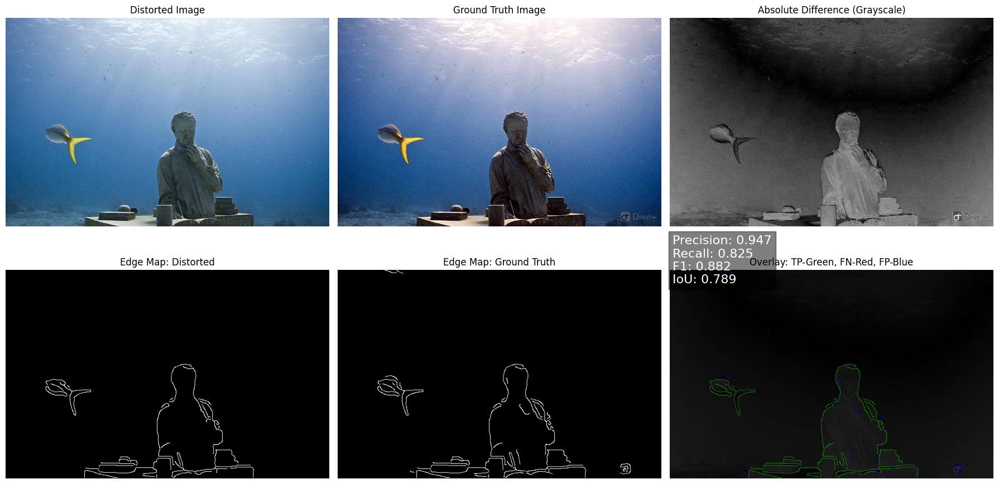

In [24]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from skimage.feature import canny

# ---------------- Edge Map Function ----------------
# def get_edge_map(image, sigma=2):
#     image = image.detach().cpu()
#     is_batched = len(image.shape) == 4

#     if is_batched:
#         edge_maps = []
#         for i in range(image.shape[0]):
#             img_np = image[i].numpy().transpose(1,2,0)
#             img_np = (img_np + 1) / 2
#             edges = canny(img_np.mean(axis=2), sigma=sigma)
#             edge_maps.append(torch.tensor(edges, dtype=torch.float32))
#         return torch.stack(edge_maps, dim=0).unsqueeze(1)
#     else:
#         img_np = image.numpy().transpose(1,2,0)
#         img_np = (img_np + 1) / 2
#         edges = canny(img_np.mean(axis=2), sigma=sigma)
#         return torch.tensor(edges, dtype=torch.float32).unsqueeze(0)

# ---------------- Load Images ----------------


        
distorted_path = r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB\raw\48_img_.png'

ground_truth_path = r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB\reference\48_img_.png'



distorted = cv2.imread(distorted_path)
ground_truth = cv2.imread(ground_truth_path)

if distorted is None or ground_truth is None:
    raise FileNotFoundError("Check your file paths; images not loaded.")

# Resize GT if mismatch
if distorted.shape != ground_truth.shape:
    ground_truth = cv2.resize(ground_truth, (distorted.shape[1], distorted.shape[0]))

# ---------------- Preprocess ----------------
distorted_gray = cv2.cvtColor(distorted, cv2.COLOR_BGR2GRAY)
ground_truth_gray = cv2.cvtColor(ground_truth, cv2.COLOR_BGR2GRAY)
diff_gray = cv2.absdiff(distorted_gray, ground_truth_gray)

# ---------------- Edge Maps ----------------
distorted_tensor = torch.from_numpy(distorted.transpose(2,0,1)).float()/127.5 - 1
ground_truth_tensor = torch.from_numpy(ground_truth.transpose(2,0,1)).float()/127.5 - 1

edge_distorted = get_edge_map(distorted_tensor).squeeze().numpy().astype(bool)
edge_gt = get_edge_map(ground_truth_tensor).squeeze().numpy().astype(bool)

# ---------------- Edge Metrics ----------------
tp = np.sum(edge_distorted & edge_gt)
fn = np.sum(edge_gt & (~edge_distorted))
fp = np.sum(edge_distorted & (~edge_gt))
tn = np.sum(~edge_distorted & ~edge_gt)
total = edge_distorted.size

precision = tp / (tp + fp) if tp + fp > 0 else 0
recall = tp / (tp + fn) if tp + fn > 0 else 0
f1 = 2 * precision * recall / (precision + recall) if precision + recall > 0 else 0
accuracy = (tp + tn) / total
iou = tp / (tp + fp + fn) if tp + fp + fn > 0 else 0

# ---------------- Overlay Visualization ----------------
overlay = cv2.cvtColor(diff_gray, cv2.COLOR_GRAY2RGB).astype(np.float32)/255.0
alpha = 0.5
overlay[edge_distorted & edge_gt] = (1-alpha)*overlay[edge_distorted & edge_gt] + alpha*np.array([0,1,0]) # TP: Green
overlay[edge_gt & (~edge_distorted)] = (1-alpha)*overlay[edge_gt & (~edge_distorted)] + alpha*np.array([1,0,0]) # FN: Red
overlay[edge_distorted & (~edge_gt)] = (1-alpha)*overlay[edge_distorted & (~edge_gt)] + alpha*np.array([0,0,1]) # FP: Blue
overlay = np.clip(overlay*255,0,255).astype(np.uint8)

# ---------------- Plot ----------------
plt.figure(figsize=(18,9))

images = [distorted, ground_truth, diff_gray, edge_distorted, edge_gt, overlay]
titles = [
    "Distorted Image",
    "Ground Truth Image",
    "Absolute Difference (Grayscale)",
    "Edge Map: Distorted",
    "Edge Map: Ground Truth",
    "Overlay: TP-Green, FN-Red, FP-Blue"
]

for i, (img, title) in enumerate(zip(images, titles), 1):
    plt.subplot(2,3,i)
    if img.ndim == 2:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title, fontsize=12)
    plt.axis('off')

    # Add metrics text to the overlay subplot
    if title.startswith("Overlay"):
        metrics_text = (
            f"Precision: {precision:.3f}\n"
            f"Recall: {recall:.3f}\n"
            f"F1: {f1:.3f}\n"
            f"IoU: {iou:.3f}"
        )
        plt.text(
            5, 25, metrics_text, color='white', fontsize=16,
            bbox=dict(facecolor='black', alpha=0.5, pad=5)
        )

plt.tight_layout()
plt.savefig("edge_analysis_paper_ready_with_metrics.png", dpi=600, bbox_inches='tight')
plt.show()


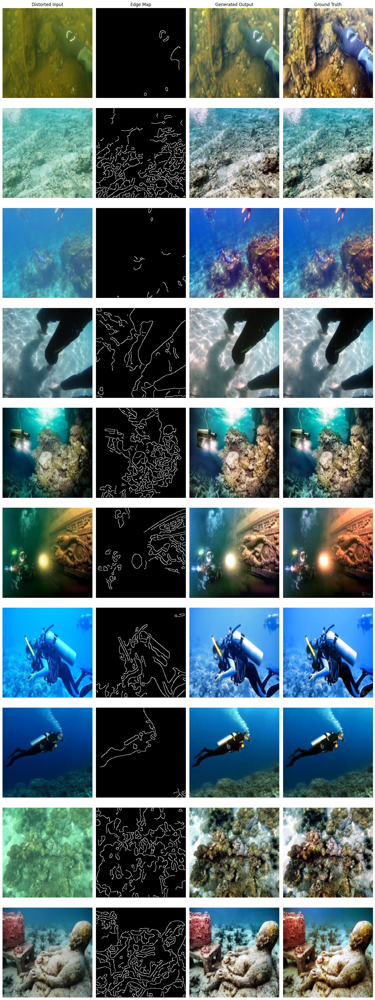

In [15]:
import torch
import random
import matplotlib.pyplot as plt
import numpy as np

def visualize_results(loader, num_samples=4, save_path="test_results.png"):
    # Load best generator
    generator.load_state_dict(torch.load("generator_best.pth"))
    generator.eval()

    # Collect all samples from the loader
    all_distorted = []
    all_ground_truth = []
    for distorted, ground_truth in loader:
        all_distorted.append(distorted)
        all_ground_truth.append(ground_truth)
    all_distorted = torch.cat(all_distorted, dim=0)
    all_ground_truth = torch.cat(all_ground_truth, dim=0)

    # Pick random indices
    total_samples = all_distorted.size(0)
    indices = random.sample(range(total_samples), num_samples)

    # Initialize storage for further operations
    distorted_images = []
    edge_maps = []
    generated_images = []
    ground_truth_images = []

    # Prepare plot
    fig, axs = plt.subplots(num_samples, 4, figsize=(15, 4 * num_samples))

    if num_samples == 1:
        axs = axs.reshape(1, -1)

    for i, idx in enumerate(indices):
        distorted = all_distorted[idx].unsqueeze(0).to(device)
        ground_truth = all_ground_truth[idx].unsqueeze(0).to(device)

        with torch.no_grad():
            fake = generator(distorted)

        # Process for visualization
        distorted_np = distorted[0, :3].cpu().numpy().transpose(1, 2, 0)
        edge_np = distorted[0, 3].cpu().numpy()
        fake_np = fake[0].cpu().numpy().transpose(1, 2, 0)
        gt_np = ground_truth[0].cpu().numpy().transpose(1, 2, 0)

        # Denormalize [-1,1] -> [0,1]
        distorted_np = (distorted_np + 1) / 2
        fake_np = (fake_np + 1) / 2
        gt_np = (gt_np + 1) / 2

        # Save for further use
        distorted_images.append(distorted_np)
        edge_maps.append(edge_np)
        generated_images.append(fake_np)
        ground_truth_images.append(gt_np)

        # Plot
        axs[i, 0].imshow(distorted_np)
        axs[0, 0].set_title("Distorted Input")
        axs[i, 1].imshow(edge_np, cmap='gray')
        axs[0, 1].set_title("Edge Map")
        axs[i, 2].imshow(fake_np)
        axs[0, 2].set_title("Generated Output")
        axs[i, 3].imshow(gt_np)
        axs[0, 3].set_title("Ground Truth")

        for ax in axs[i]:
            ax.axis("off")

    plt.tight_layout()
    plt.savefig(save_path, dpi=1200, bbox_inches="tight")
    plt.show()

    # Return the data for further operations
    return {
        "distorted": distorted_images,
        "edges": edge_maps,
        "generated": generated_images,
        "ground_truth": ground_truth_images
    }

# Example Usage:
results = visualize_results(test_loader, num_samples=10, save_path="test_results.png")



--- Image 1 (Index 98) ---
[Distorted vs Ground Truth]
TP: 6537, FN: 2718, FP: 1427, TN: 54854
Precision: 0.8208, Recall: 0.7063, F1: 0.7593, Acc: 0.9368, IoU: 0.6120

[Generated vs Ground Truth]
TP: 7932, FN: 1323, FP: 1466, TN: 54815
Precision: 0.8440, Recall: 0.8571, F1: 0.8505, Acc: 0.9574, IoU: 0.7399


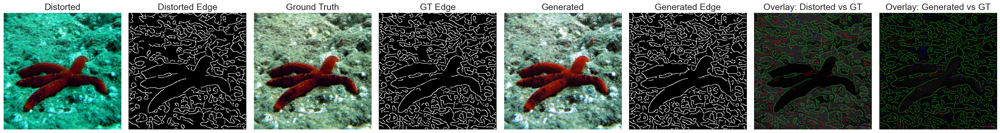


--- Image 2 (Index 55) ---
[Distorted vs Ground Truth]
TP: 787, FN: 2776, FP: 50, TN: 61923
Precision: 0.9403, Recall: 0.2209, F1: 0.3577, Acc: 0.9569, IoU: 0.2178

[Generated vs Ground Truth]
TP: 3226, FN: 337, FP: 1684, TN: 60289
Precision: 0.6570, Recall: 0.9054, F1: 0.7615, Acc: 0.9692, IoU: 0.6148


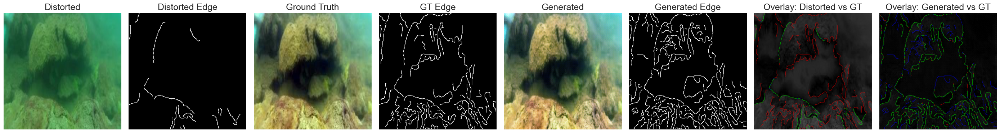


--- Image 3 (Index 43) ---
[Distorted vs Ground Truth]
TP: 1088, FN: 2205, FP: 117, TN: 62126
Precision: 0.9029, Recall: 0.3304, F1: 0.4838, Acc: 0.9646, IoU: 0.3191

[Generated vs Ground Truth]
TP: 2651, FN: 642, FP: 328, TN: 61915
Precision: 0.8899, Recall: 0.8050, F1: 0.8453, Acc: 0.9852, IoU: 0.7321


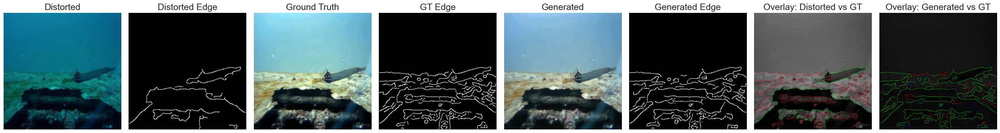


--- Image 4 (Index 131) ---
[Distorted vs Ground Truth]
TP: 1705, FN: 2391, FP: 56, TN: 61384
Precision: 0.9682, Recall: 0.4163, F1: 0.5822, Acc: 0.9627, IoU: 0.4106

[Generated vs Ground Truth]
TP: 3619, FN: 477, FP: 693, TN: 60747
Precision: 0.8393, Recall: 0.8835, F1: 0.8608, Acc: 0.9821, IoU: 0.7557


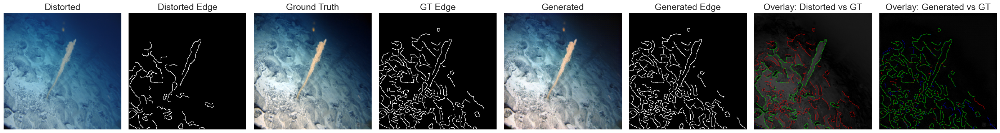


--- Image 5 (Index 12) ---
[Distorted vs Ground Truth]
TP: 706, FN: 835, FP: 99, TN: 63896
Precision: 0.8770, Recall: 0.4581, F1: 0.6019, Acc: 0.9857, IoU: 0.4305

[Generated vs Ground Truth]
TP: 1042, FN: 499, FP: 235, TN: 63760
Precision: 0.8160, Recall: 0.6762, F1: 0.7395, Acc: 0.9888, IoU: 0.5867


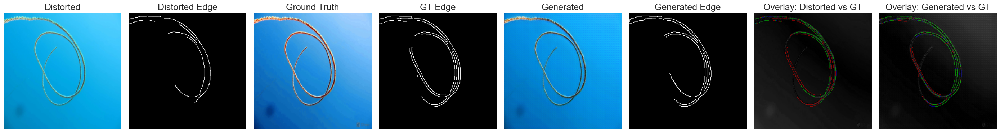


--- Image 6 (Index 103) ---
[Distorted vs Ground Truth]
TP: 1412, FN: 3017, FP: 352, TN: 60755
Precision: 0.8005, Recall: 0.3188, F1: 0.4560, Acc: 0.9486, IoU: 0.2953

[Generated vs Ground Truth]
TP: 4007, FN: 422, FP: 845, TN: 60262
Precision: 0.8258, Recall: 0.9047, F1: 0.8635, Acc: 0.9807, IoU: 0.7598


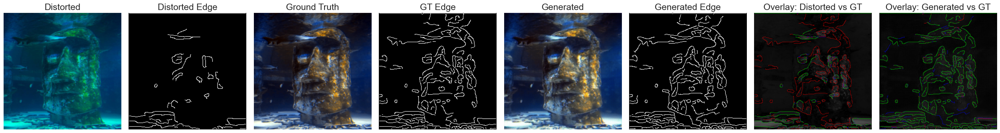


--- Image 7 (Index 82) ---
[Distorted vs Ground Truth]
TP: 98, FN: 5242, FP: 9, TN: 60187
Precision: 0.9159, Recall: 0.0184, F1: 0.0360, Acc: 0.9199, IoU: 0.0183

[Generated vs Ground Truth]
TP: 2252, FN: 3088, FP: 650, TN: 59546
Precision: 0.7760, Recall: 0.4217, F1: 0.5465, Acc: 0.9430, IoU: 0.3760


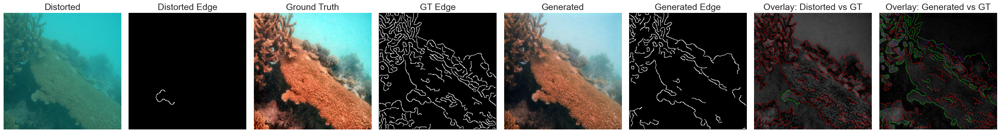


--- Image 8 (Index 127) ---
[Distorted vs Ground Truth]
TP: 3403, FN: 4990, FP: 1429, TN: 55714
Precision: 0.7043, Recall: 0.4055, F1: 0.5146, Acc: 0.9021, IoU: 0.3465

[Generated vs Ground Truth]
TP: 4291, FN: 4102, FP: 1587, TN: 55556
Precision: 0.7300, Recall: 0.5113, F1: 0.6014, Acc: 0.9132, IoU: 0.4300


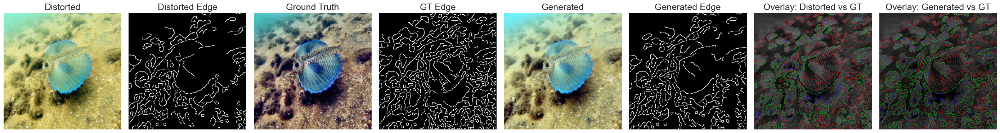


--- Image 9 (Index 118) ---
[Distorted vs Ground Truth]
TP: 3017, FN: 5784, FP: 623, TN: 56112
Precision: 0.8288, Recall: 0.3428, F1: 0.4850, Acc: 0.9022, IoU: 0.3201

[Generated vs Ground Truth]
TP: 7831, FN: 970, FP: 888, TN: 55847
Precision: 0.8982, Recall: 0.8898, F1: 0.8939, Acc: 0.9716, IoU: 0.8082


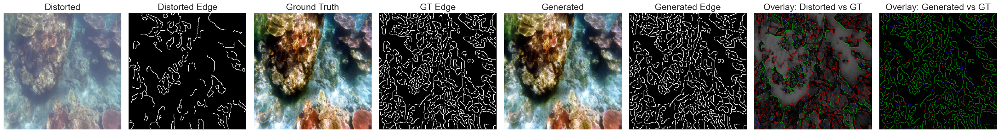


--- Image 10 (Index 33) ---
[Distorted vs Ground Truth]
TP: 4800, FN: 1929, FP: 444, TN: 58363
Precision: 0.9153, Recall: 0.7133, F1: 0.8018, Acc: 0.9638, IoU: 0.6692

[Generated vs Ground Truth]
TP: 5964, FN: 765, FP: 1563, TN: 57244
Precision: 0.7923, Recall: 0.8863, F1: 0.8367, Acc: 0.9645, IoU: 0.7192


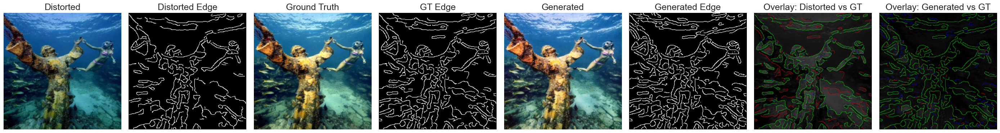

In [33]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from skimage.feature import canny
import os
import random
from scipy.ndimage import binary_erosion, binary_dilation



# --- Create directory ---
os.makedirs("edge_analysis_results", exist_ok=True)

# --- Take 10 random image indices ---
num_images = len(results["distorted"])
random_indices = random.sample(range(num_images), 10)

for idx, real_idx in enumerate(random_indices):
    distorted_np = results["distorted"][real_idx]
    ground_truth_np = results["ground_truth"][real_idx]
    generated_np = results["generated"][real_idx]

    # Convert to tensors
    distorted_tensor = torch.from_numpy(distorted_np.transpose(2, 0, 1)).float() * 2 - 1
    ground_truth_tensor = torch.from_numpy(ground_truth_np.transpose(2, 0, 1)).float() * 2 - 1
    generated_tensor = torch.from_numpy(generated_np.transpose(2, 0, 1)).float() * 2 - 1

    # Get edge maps
    edge_map_gt = get_edge_map(ground_truth_tensor).squeeze().numpy().astype(bool)
    edge_map_pred = get_edge_map(generated_tensor).squeeze().numpy().astype(bool)
    edge_map_distorted = get_edge_map(distorted_tensor).squeeze().numpy().astype(bool)

    # --- Compute gray diff ---
    distorted_gray = cv2.cvtColor((distorted_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    ground_truth_gray = cv2.cvtColor((ground_truth_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    generated_gray = cv2.cvtColor((generated_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    diff_gray_input = cv2.absdiff(distorted_gray, ground_truth_gray)
    diff_gray_gen = cv2.absdiff(generated_gray, ground_truth_gray)

    total_pixels = edge_map_gt.size

    # --- Metrics: distorted vs GT ---
    tp_d = edge_map_distorted & edge_map_gt
    fn_d = edge_map_gt & (~edge_map_distorted)
    fp_d = edge_map_distorted & (~edge_map_gt)
    tn_d = (~edge_map_distorted) & (~edge_map_gt)

    TP_d, FN_d, FP_d, TN_d = map(np.sum, [tp_d, fn_d, fp_d, tn_d])
    precision_d = TP_d / (TP_d + FP_d) if (TP_d + FP_d) > 0 else 0
    recall_d = TP_d / (TP_d + FN_d) if (TP_d + FN_d) > 0 else 0
    f1_score_d = (2 * precision_d * recall_d) / (precision_d + recall_d) if (precision_d + recall_d) > 0 else 0
    accuracy_d = (TP_d + TN_d) / total_pixels
    jaccard_d = TP_d / (TP_d + FP_d + FN_d) if (TP_d + FP_d + FN_d) > 0 else 0

    # --- Metrics: generated vs GT ---
    tp_g = edge_map_pred & edge_map_gt
    fn_g = edge_map_gt & (~edge_map_pred)
    fp_g = edge_map_pred & (~edge_map_gt)
    tn_g = (~edge_map_pred) & (~edge_map_gt)

    TP_g, FN_g, FP_g, TN_g = map(np.sum, [tp_g, fn_g, fp_g, tn_g])
    precision_g = TP_g / (TP_g + FP_g) if (TP_g + FP_g) > 0 else 0
    recall_g = TP_g / (TP_g + FN_g) if (TP_g + FN_g) > 0 else 0
    f1_score_g = (2 * precision_g * recall_g) / (precision_g + recall_g) if (precision_g + recall_g) > 0 else 0
    accuracy_g = (TP_g + TN_g) / total_pixels
    jaccard_g = TP_g / (TP_g + FP_g + FN_g) if (TP_g + FP_g + FN_g) > 0 else 0

    print(f"\n--- Image {idx + 1} (Index {real_idx}) ---")
    print("[Distorted vs Ground Truth]")
    print(f"TP: {TP_d}, FN: {FN_d}, FP: {FP_d}, TN: {TN_d}")
    print(f"Precision: {precision_d:.4f}, Recall: {recall_d:.4f}, F1: {f1_score_d:.4f}, Acc: {accuracy_d:.4f}, IoU: {jaccard_d:.4f}")

    print("\n[Generated vs Ground Truth]")
    print(f"TP: {TP_g}, FN: {FN_g}, FP: {FP_g}, TN: {TN_g}")
    print(f"Precision: {precision_g:.4f}, Recall: {recall_g:.4f}, F1: {f1_score_g:.4f}, Acc: {accuracy_g:.4f}, IoU: {jaccard_g:.4f}")

    # --- Overlay creation ---
    def create_overlay(diff_gray, tp_mask, fn_mask, fp_mask):
        overlay = cv2.cvtColor(diff_gray, cv2.COLOR_GRAY2RGB).astype(np.float32) / 255.0
        alpha = 0.5
        overlay[tp_mask] = (1 - alpha) * overlay[tp_mask] + alpha * np.array([0, 1, 0])   # Green
        overlay[fn_mask] = (1 - alpha) * overlay[fn_mask] + alpha * np.array([1, 0, 0])   # Red
        overlay[fp_mask] = (1 - alpha) * overlay[fp_mask] + alpha * np.array([0, 0, 1])   # Blue
        return np.clip(overlay * 255, 0, 255).astype(np.uint8)

    overlay_input = create_overlay(diff_gray_input, tp_d, fn_d, fp_d)
    overlay_generated = create_overlay(diff_gray_gen, tp_g, fn_g, fp_g)

    # --- Plot all in a row ---
    plt.figure(figsize=(28, 6))
    images = [
        (distorted_np, "Distorted"), (edge_map_distorted, "Distorted Edge"),
        (ground_truth_np, "Ground Truth"), (edge_map_gt, "GT Edge"),
        (generated_np, "Generated"), (edge_map_pred, "Generated Edge"),
        (overlay_input, "Overlay: Distorted vs GT"), (overlay_generated, "Overlay: Generated vs GT"),
    ]

    for i, (img, title) in enumerate(images):
        plt.subplot(1, len(images), i + 1)
        if img.ndim == 2:
            plt.imshow(img, cmap='gray')
        else:
            plt.imshow(img)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    save_name = f"edge_analysis_results/image_{idx+1:02d}_fullrow.png"
    plt.savefig(save_name, dpi=1200, bbox_inches='tight')
    plt.show()
    plt.close()


In [16]:
import torch
import numpy as np
from tqdm import tqdm

def compute_overall_edge_metrics(generator, test_loader, device, sigma=1.5):
    """
    Compute overall edge detection metrics for the test dataset.
    Args:
        generator: The trained generator model.
        test_loader: DataLoader for the test dataset.
        device: Device to run the computation (cuda or cpu).
        sigma: Sigma parameter for the Canny edge detector.
    Returns:
        dict: Metrics for Distorted vs GT and Generated vs GT.
    """
    sigma = 1.5
    generator.eval()
    total_pixels = 0
    metrics = {
        'distorted_vs_gt': {'TP': 0, 'FN': 0, 'FP': 0, 'TN': 0},
        'generated_vs_gt': {'TP': 0, 'FN': 0, 'FP': 0, 'TN': 0}
    }

    with torch.no_grad():
        for distorted, ground_truth in tqdm(test_loader, desc="Computing Edge Metrics"):
            distorted, ground_truth = distorted.to(device), ground_truth.to(device)
            # Generate images
            generated = generator(distorted)

            # Compute edge maps
            edge_map_distorted = get_edge_map(distorted[:, :3]).squeeze(1).cpu().numpy().astype(bool)
            edge_map_gt = get_edge_map(ground_truth).squeeze(1).cpu().numpy().astype(bool)
            edge_map_generated = get_edge_map(generated).squeeze(1).cpu().numpy().astype(bool)

            # Process each image in the batch
            for i in range(distorted.shape[0]):
                # Distorted vs Ground Truth
                tp_d = edge_map_distorted[i] & edge_map_gt[i]
                fn_d = edge_map_gt[i] & (~edge_map_distorted[i])
                fp_d = edge_map_distorted[i] & (~edge_map_gt[i])
                tn_d = (~edge_map_distorted[i]) & (~edge_map_gt[i])

                metrics['distorted_vs_gt']['TP'] += np.sum(tp_d)
                metrics['distorted_vs_gt']['FN'] += np.sum(fn_d)
                metrics['distorted_vs_gt']['FP'] += np.sum(fp_d)
                metrics['distorted_vs_gt']['TN'] += np.sum(tn_d)

                # Generated vs Ground Truth
                tp_g = edge_map_generated[i] & edge_map_gt[i]
                fn_g = edge_map_gt[i] & (~edge_map_generated[i])
                fp_g = edge_map_generated[i] & (~edge_map_gt[i])
                tn_g = (~edge_map_generated[i]) & (~edge_map_gt[i])

                metrics['generated_vs_gt']['TP'] += np.sum(tp_g)
                metrics['generated_vs_gt']['FN'] += np.sum(fn_g)
                metrics['generated_vs_gt']['FP'] += np.sum(fp_g)
                metrics['generated_vs_gt']['TN'] += np.sum(tn_g)

                total_pixels += edge_map_gt[i].size

    # Calculate derived metrics
    results = {}
    for key in metrics:
        TP, FN, FP, TN = [metrics[key][k] for k in ['TP', 'FN', 'FP', 'TN']]
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        accuracy = (TP + TN) / total_pixels if total_pixels > 0 else 0
        jaccard = TP / (TP + FP + FN) if (TP + FP + FN) > 0 else 0

        results[key] = {
            'TP': TP,
            'FN': FN,
            'FP': FP,
            'TN': TN,
            'Precision': precision,
            'Recall': recall,
            'F1': f1_score,
            'Accuracy': accuracy,
            'IoU': jaccard
        }

    return results, total_pixels

# Example usage
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
results, total_pixels = compute_overall_edge_metrics(generator, test_loader, device, sigma=1.5)

# Print results
print(f"\n--- Overall Edge Detection Metrics (Test Dataset) ---")
print(f"Total Pixels: {total_pixels}")
for key in results:
    print(f"\n[{key.replace('_', ' ').title()}]")
    print(f"TP: {results[key]['TP']}, FN: {results[key]['FN']}, FP: {results[key]['FP']}, TN: {results[key]['TN']}")
    print(f"Precision: {results[key]['Precision']:.4f}, Recall: {results[key]['Recall']:.4f}, "
          f"F1: {results[key]['F1']:.4f}, Acc: {results[key]['Accuracy']:.4f}, IoU: {results[key]['IoU']:.4f}")



Computing Edge Metrics: 100%|██████████████████████████████████████████████████████████| 45/45 [00:17<00:00,  2.61it/s]


--- Overall Edge Detection Metrics (Test Dataset) ---
Total Pixels: 11665408

[Distorted Vs Gt]
TP: 471118, FN: 539124, FP: 74600, TN: 10580566
Precision: 0.8633, Recall: 0.4663, F1: 0.6056, Acc: 0.9474, IoU: 0.4343

[Generated Vs Gt]
TP: 786790, FN: 223452, FP: 226480, TN: 10428686
Precision: 0.7765, Recall: 0.7788, F1: 0.7776, Acc: 0.9614, IoU: 0.6362


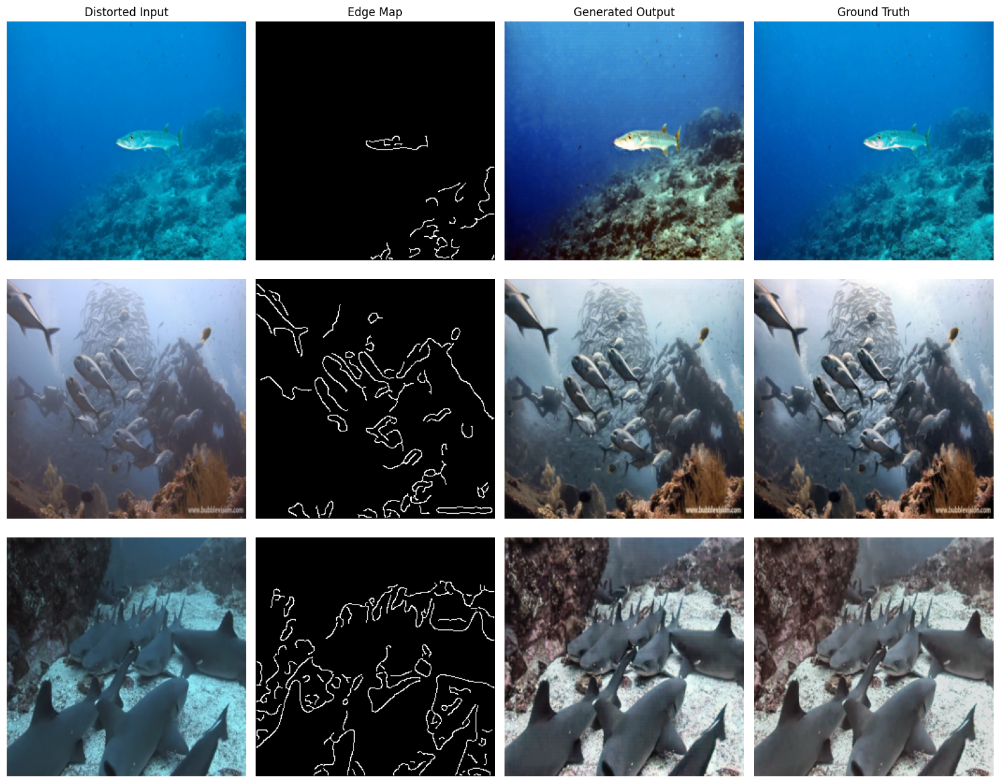

In [19]:
# ========== 9. Visualization ==========
def visualize_results(loader, num_samples=10, save_path="results.png"):
    # Load best generator
    generator.load_state_dict(torch.load("generator_best.pth"))
    generator.eval()
    
    # Get sample batch
    distorted, ground_truth = next(iter(loader))
    distorted, ground_truth = distorted.to(device), ground_truth.to(device)
    
    with torch.no_grad():
        fake = generator(distorted)
    
    # Prepare plots
    fig, axs = plt.subplots(num_samples, 4, figsize=(15, 4*num_samples))
    if num_samples == 1:
        axs = axs.reshape(1, -1)
    
    for i in range(num_samples):
        # Process images
        distorted_np = distorted[i, :3].cpu().numpy().transpose(1, 2, 0)
        edge_np = distorted[i, 3].cpu().numpy()
        fake_np = fake[i].cpu().numpy().transpose(1, 2, 0)
        gt_np = ground_truth[i].cpu().numpy().transpose(1, 2, 0)
        
        # Denormalize [-1,1] -> [0,1]
        distorted_np = (distorted_np + 1) / 2
        fake_np = (fake_np + 1) / 2
        gt_np = (gt_np + 1) / 2
        
        # Plot
        axs[i,0].imshow(distorted_np)
        axs[0,0].set_title("Distorted Input")
        axs[i,1].imshow(edge_np, cmap='gray')
        axs[0,1].set_title("Edge Map")
        axs[i,2].imshow(fake_np)
        axs[0,2].set_title("Generated Output")
        axs[i,3].imshow(gt_np)
        axs[0,3].set_title("Ground Truth")
        
        for ax in axs[i]:
            ax.axis('off')
    
    plt.tight_layout()
    plt.savefig(save_path, dpi=600, bbox_inches='tight')
    plt.show()

# Visualize test results
visualize_results(test_loader, num_samples=3, save_path="test_results.png")




--- Edge Detection Metrics ---
Total Pixels: 307200
True Positives (TP): 11307 (0.0368%)
False Negatives (FN): 22545 (0.0734%)
False Positives (FP): 4715 (0.0153%)
True Negatives (TN): 268633 (0.8745%)

--- Derived Evaluation Metrics ---
Precision: 0.7057
Recall: 0.3340
F1-Score: 0.4534
Accuracy: 0.9113
Jaccard Index (IoU): 0.2932


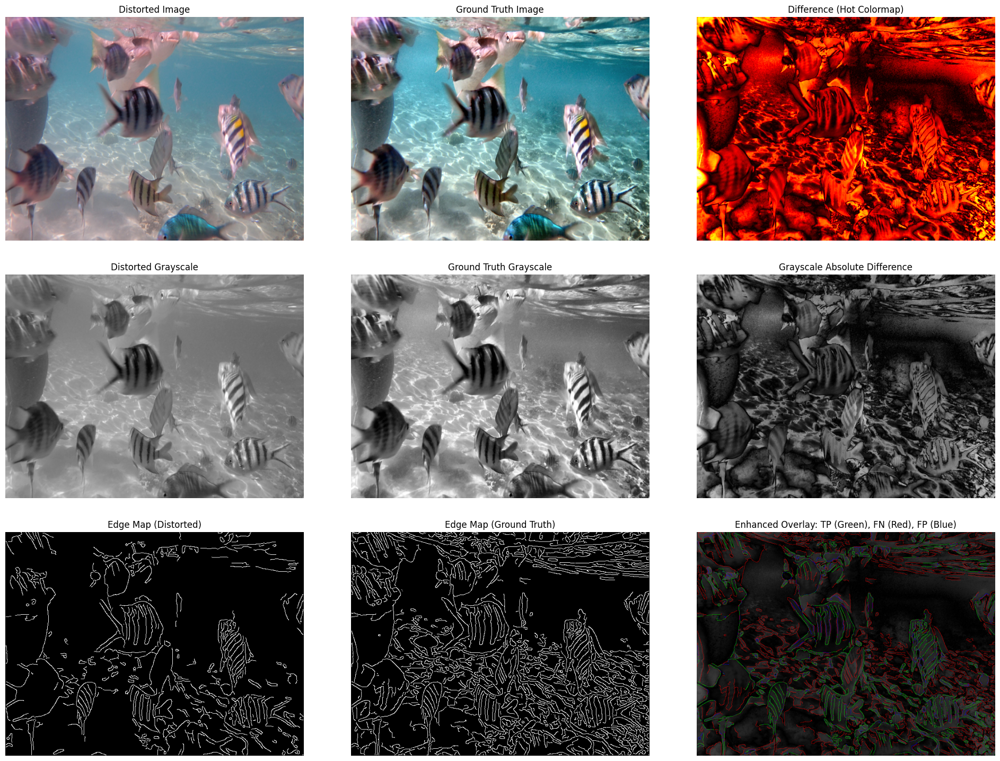

In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from skimage.feature import canny
from scipy.ndimage import binary_erosion, binary_dilation

# --- Edge Map Function ---
def get_edge_map(image, sigma=2):
    image = image.detach().cpu()
    is_batched = len(image.shape) == 4

    if is_batched:
        batch_size = image.shape[0]
        edge_maps = []
        for i in range(batch_size):
            img_np = image[i].numpy().transpose(1, 2, 0)
            img_np = (img_np + 1) / 2 # Normalize to [0, 1]
            edges = canny(img_np.mean(axis=2), sigma=sigma)
            edge_maps.append(torch.tensor(edges, dtype=torch.float32))
        return torch.stack(edge_maps, dim=0).unsqueeze(1).to(image.device)
    else:
        img_np = image.numpy().transpose(1, 2, 0)
        img_np = (img_np + 1) / 2 # Normalize to [0, 1]
        edges = canny(img_np.mean(axis=2), sigma=sigma)
        return torch.tensor(edges, dtype=torch.float32).unsqueeze(0)

# --- Load distorted and ground truth images ---
distorted_path = r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB\raw\23_img_.png'
ground_truth_path = r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB\reference\23_img_.png'

distorted = cv2.imread(distorted_path)
ground_truth = cv2.imread(ground_truth_path)

if distorted is None:
    print(f"Error: Could not load distorted image from {distorted_path}")
    exit()
if ground_truth is None:
    print(f"Error: Could not load ground truth image from {ground_truth_path}")
    exit()

# Resize ground truth if shapes mismatch
if distorted.shape != ground_truth.shape:
    ground_truth = cv2.resize(ground_truth, (distorted.shape[1], distorted.shape[0]))

# Grayscale conversions
distorted_gray = cv2.cvtColor(distorted, cv2.COLOR_BGR2GRAY)
ground_truth_gray = cv2.cvtColor(ground_truth, cv2.COLOR_BGR2GRAY)

# Grayscale absolute difference
diff = cv2.absdiff(distorted_gray, ground_truth_gray)

# --- Edge map from distorted image ---
distorted_tensor = torch.from_numpy(distorted.transpose(2, 0, 1)).float() / 127.5 - 1
edge_map_distorted_tensor = get_edge_map(distorted_tensor, sigma=1.5)
edge_map_distorted = edge_map_distorted_tensor.squeeze().numpy().astype(bool)

# --- Edge map from ground truth image ---
ground_truth_tensor = torch.from_numpy(ground_truth.transpose(2, 0, 1)).float() / 127.5 - 1
edge_map_gt_tensor = get_edge_map(ground_truth_tensor, sigma=1.5)
edge_map_gt = edge_map_gt_tensor.squeeze().numpy().astype(bool)

# --- Calculate True Positives, False Negatives, False Positives ---
tp_mask = edge_map_distorted & edge_map_gt
fn_mask = edge_map_gt & (~edge_map_distorted)
fp_mask = edge_map_distorted & (~edge_map_gt)
tn_mask = (~edge_map_distorted) & (~edge_map_gt) # True Negatives

# Count the pixels for each category
TP = np.sum(tp_mask)
FN = np.sum(fn_mask)
FP = np.sum(fp_mask)
TN = np.sum(tn_mask)

# Total pixels for reference
total_pixels = edge_map_distorted.size # Or edge_map_gt.size, they should be the same

print(f"--- Edge Detection Metrics ---")
print(f"Total Pixels: {total_pixels}")
print(f"True Positives (TP): {TP} ({TP/total_pixels:.4f}%)")
print(f"False Negatives (FN): {FN} ({FN/total_pixels:.4f}%)")
print(f"False Positives (FP): {FP} ({FP/total_pixels:.4f}%)")
print(f"True Negatives (TN): {TN} ({TN/total_pixels:.4f}%)")

# Calculate Derived Metrics
precision = TP / (TP + FP) if (TP + FP) > 0 else 0
recall = TP / (TP + FN) if (TP + FN) > 0 else 0
f1_score = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
accuracy = (TP + TN) / total_pixels
jaccard_index = TP / (TP + FP + FN) if (TP + FP + FN) > 0 else 0


print(f"\n--- Derived Evaluation Metrics ---")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {f1_score:.4f}")
print(f"Accuracy: {accuracy:.4f}")
print(f"Jaccard Index (IoU): {jaccard_index:.4f}")


# --- Create colored overlay for visualization ---
overlay_enhanced = cv2.cvtColor(diff, cv2.COLOR_GRAY2RGB).astype(np.float32) / 255.0

color_tp = np.array([0, 1, 0])   # Green for True Positives
color_fn = np.array([1, 0, 0])   # Red for False Negatives (missing edges)
color_fp = np.array([0, 0, 1])   # Blue for False Positives (spurious edges)
alpha = 0.5 # Transparency level for overlays

overlay_enhanced[tp_mask] = (1 - alpha) * overlay_enhanced[tp_mask] + alpha * color_tp
overlay_enhanced[fn_mask] = (1 - alpha) * overlay_enhanced[fn_mask] + alpha * color_fn
overlay_enhanced[fp_mask] = (1 - alpha) * overlay_enhanced[fp_mask] + alpha * color_fp

overlay_enhanced = np.clip(overlay_enhanced * 255, 0, 255).astype(np.uint8)

# --- Plotting All Images with Enhanced Overlay ---
plt.figure(figsize=(20, 15))

titles = [
    "Distorted Image",
    "Ground Truth Image",
    "Difference (Hot Colormap)",
    "Distorted Grayscale",
    "Ground Truth Grayscale",
    "Grayscale Absolute Difference",
    "Edge Map (Distorted)",
    "Edge Map (Ground Truth)",
    "Enhanced Overlay: TP (Green), FN (Red), FP (Blue)"
]

plt.subplot(3, 3, 1)
plt.title(titles[0], fontsize=12)
plt.imshow(cv2.cvtColor(distorted, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(3, 3, 2)
plt.title(titles[1], fontsize=12)
plt.imshow(cv2.cvtColor(ground_truth, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(3, 3, 3)
plt.title(titles[2], fontsize=12)
plt.imshow(diff, cmap='hot')
plt.axis('off')

plt.subplot(3, 3, 4)
plt.title(titles[3], fontsize=12)
plt.imshow(distorted_gray, cmap='gray')
plt.axis('off')

plt.subplot(3, 3, 5)
plt.title(titles[4], fontsize=12)
plt.imshow(ground_truth_gray, cmap='gray')
plt.axis('off')

plt.subplot(3, 3, 6)
plt.title(titles[5], fontsize=12)
plt.imshow(diff, cmap='gray')
plt.axis('off')

plt.subplot(3, 3, 7)
plt.title(titles[6], fontsize=12)
plt.imshow(edge_map_distorted, cmap='gray')
plt.axis('off')

plt.subplot(3, 3, 8)
plt.title(titles[7], fontsize=12)
plt.imshow(edge_map_gt, cmap='gray')
plt.axis('off')

plt.subplot(3, 3, 9)
plt.title(titles[8], fontsize=12)
plt.imshow(overlay_enhanced)
plt.axis('off')

plt.tight_layout(pad=3.0)
plt.savefig("research_paper_visualization_with_edge_analysis_and_metrics.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()

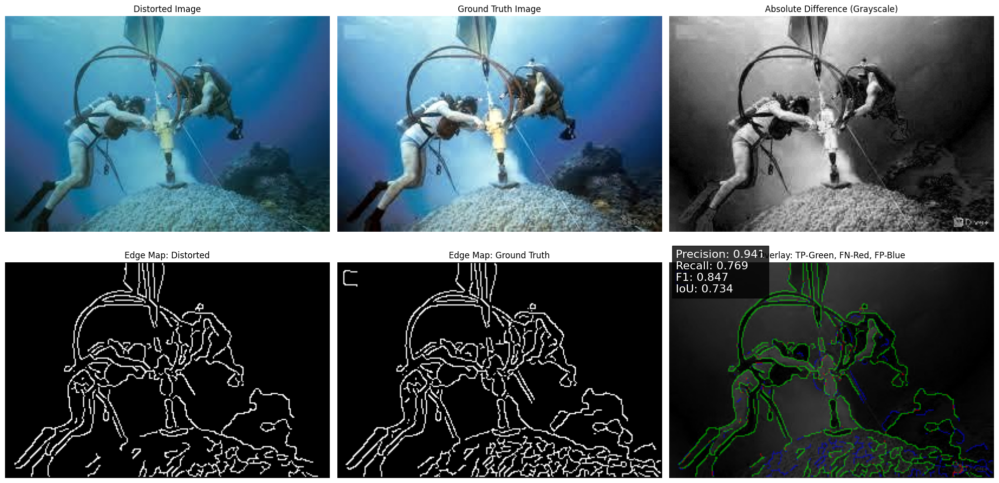

In [29]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from skimage.feature import canny

# ---------------- Edge Map Function ----------------
def get_edge_map(image, sigma=2):
    image = image.detach().cpu()
    is_batched = len(image.shape) == 4

    if is_batched:
        edge_maps = []
        for i in range(image.shape[0]):
            img_np = image[i].numpy().transpose(1,2,0)
            img_np = (img_np + 1) / 2
            edges = canny(img_np.mean(axis=2), sigma=sigma)
            edge_maps.append(torch.tensor(edges, dtype=torch.float32))
        return torch.stack(edge_maps, dim=0).unsqueeze(1)
    else:
        img_np = image.numpy().transpose(1,2,0)
        img_np = (img_np + 1) / 2
        edges = canny(img_np.mean(axis=2), sigma=sigma)
        return torch.tensor(edges, dtype=torch.float32).unsqueeze(0)

# ---------------- Load Images ----------------
distorted_path = r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB\raw\303_img_.png'
ground_truth_path = r'C:\Users\plawa\anaconda3\envs\underwater_gan_new\UIEB\reference\303_img_.png'



distorted = cv2.imread(distorted_path)
ground_truth = cv2.imread(ground_truth_path)

if distorted is None or ground_truth is None:
    raise FileNotFoundError("Check your file paths; images not loaded.")

# Resize GT if mismatch
if distorted.shape != ground_truth.shape:
    ground_truth = cv2.resize(ground_truth, (distorted.shape[1], distorted.shape[0]))

# ---------------- Preprocess ----------------
distorted_gray = cv2.cvtColor(distorted, cv2.COLOR_BGR2GRAY)
ground_truth_gray = cv2.cvtColor(ground_truth, cv2.COLOR_BGR2GRAY)
diff_gray = cv2.absdiff(distorted_gray, ground_truth_gray)

# ---------------- Edge Maps ----------------
distorted_tensor = torch.from_numpy(distorted.transpose(2,0,1)).float()/127.5 - 1
ground_truth_tensor = torch.from_numpy(ground_truth.transpose(2,0,1)).float()/127.5 - 1

edge_distorted = get_edge_map(distorted_tensor, sigma=1.5).squeeze().numpy().astype(bool)
edge_gt = get_edge_map(ground_truth_tensor, sigma=1.5).squeeze().numpy().astype(bool)

# ---------------- Edge Metrics ----------------
tp = np.sum(edge_distorted & edge_gt)
fn = np.sum(edge_gt & (~edge_distorted))
fp = np.sum(edge_distorted & (~edge_gt))
tn = np.sum(~edge_distorted & ~edge_gt)
total = edge_distorted.size

precision = tp / (tp + fp) if tp + fp > 0 else 0
recall = tp / (tp + fn) if tp + fn > 0 else 0
f1 = 2 * precision * recall / (precision + recall) if precision + recall > 0 else 0
accuracy = (tp + tn) / total
iou = tp / (tp + fp + fn) if tp + fp + fn > 0 else 0

# ---------------- Overlay Visualization ----------------
overlay = cv2.cvtColor(diff_gray, cv2.COLOR_GRAY2RGB).astype(np.float32)/255.0
alpha = 0.5
overlay[edge_distorted & edge_gt] = (1-alpha)*overlay[edge_distorted & edge_gt] + alpha*np.array([0,1,0]) # TP: Green
overlay[edge_gt & (~edge_distorted)] = (1-alpha)*overlay[edge_gt & (~edge_distorted)] + alpha*np.array([1,0,0]) # FN: Red
overlay[edge_distorted & (~edge_gt)] = (1-alpha)*overlay[edge_distorted & (~edge_gt)] + alpha*np.array([0,0,1]) # FP: Blue
overlay = np.clip(overlay*255,0,255).astype(np.uint8)

# ---------------- Plot ----------------
plt.figure(figsize=(20,10))

images = [distorted, ground_truth, diff_gray, edge_distorted, edge_gt, overlay]
titles = [
    "Distorted Image",
    "Ground Truth Image",
    "Absolute Difference (Grayscale)",
    "Edge Map: Distorted",
    "Edge Map: Ground Truth",
    "Overlay: TP-Green, FN-Red, FP-Blue"
]

for i, (img, title) in enumerate(zip(images, titles), 1):
    plt.subplot(2,3,i)
    if img.ndim == 2:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title, fontsize=12)
    plt.axis('off')

    # Add metrics text to the overlay subplot
    if title.startswith("Overlay"):
        metrics_text = (
            f"Precision: {precision:.3f}\n"
            f"Recall: {recall:.3f}\n"
            f"F1: {f1:.3f}\n"
            f"IoU: {iou:.3f}"
        )
        plt.text(
            5, 25, metrics_text, color='white', fontsize=16,
            bbox=dict(facecolor='black', alpha=0.8, pad=5)
        )

plt.tight_layout()
plt.savefig("edge_analysis_paper_ready_with_metrics.png", dpi=600, bbox_inches='tight')
plt.show()


Results collected: 178 samples

--- Image 1 (Index 139) ---
[Distorted vs Ground Truth]
TP: 3859, FN: 2030, FP: 540, TN: 59107
Precision: 0.8772, Recall: 0.6553, F1: 0.7502, Acc: 0.9608, IoU: 0.6002

[Generated vs Ground Truth]
TP: 5058, FN: 831, FP: 506, TN: 59141
Precision: 0.9091, Recall: 0.8589, F1: 0.8833, Acc: 0.9796, IoU: 0.7909


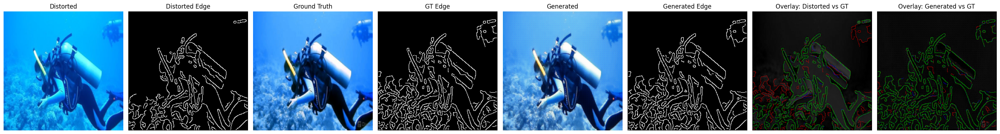


--- Image 2 (Index 153) ---
[Distorted vs Ground Truth]
TP: 1179, FN: 1677, FP: 296, TN: 62384
Precision: 0.7993, Recall: 0.4128, F1: 0.5444, Acc: 0.9699, IoU: 0.3740

[Generated vs Ground Truth]
TP: 2107, FN: 749, FP: 959, TN: 61721
Precision: 0.6872, Recall: 0.7377, F1: 0.7116, Acc: 0.9739, IoU: 0.5523


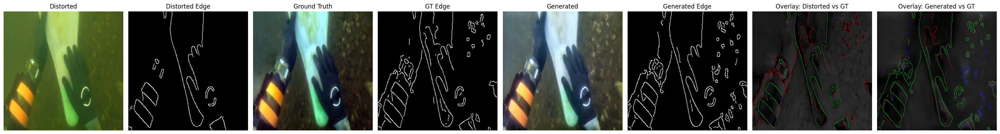


--- Image 3 (Index 4) ---
[Distorted vs Ground Truth]
TP: 826, FN: 4250, FP: 46, TN: 60414
Precision: 0.9472, Recall: 0.1627, F1: 0.2777, Acc: 0.9344, IoU: 0.1613

[Generated vs Ground Truth]
TP: 4657, FN: 419, FP: 2718, TN: 57742
Precision: 0.6315, Recall: 0.9175, F1: 0.7481, Acc: 0.9521, IoU: 0.5975


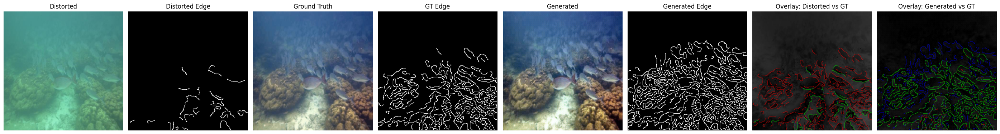


--- Image 4 (Index 54) ---
[Distorted vs Ground Truth]
TP: 4795, FN: 2214, FP: 232, TN: 58295
Precision: 0.9538, Recall: 0.6841, F1: 0.7968, Acc: 0.9627, IoU: 0.6622

[Generated vs Ground Truth]
TP: 6123, FN: 886, FP: 3608, TN: 54919
Precision: 0.6292, Recall: 0.8736, F1: 0.7315, Acc: 0.9314, IoU: 0.5767


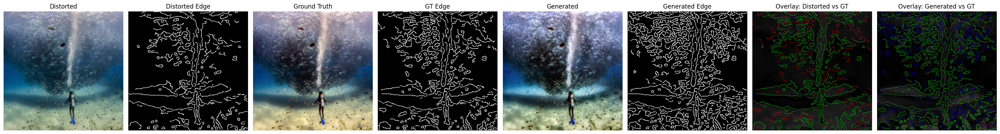


--- Image 5 (Index 81) ---
[Distorted vs Ground Truth]
TP: 3875, FN: 3525, FP: 1101, TN: 57035
Precision: 0.7787, Recall: 0.5236, F1: 0.6262, Acc: 0.9294, IoU: 0.4558

[Generated vs Ground Truth]
TP: 4676, FN: 2724, FP: 1687, TN: 56449
Precision: 0.7349, Recall: 0.6319, F1: 0.6795, Acc: 0.9327, IoU: 0.5146


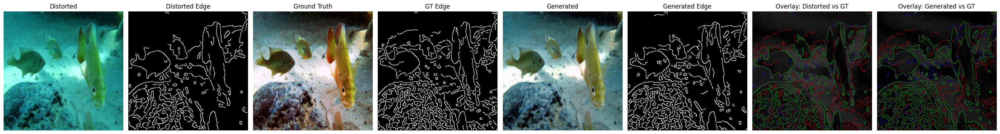

In [28]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from skimage.feature import canny
import os
import random
from scipy.ndimage import binary_erosion, binary_dilation

# === Build Results Dictionary ===
results = {"distorted": [], "ground_truth": [], "generated": []}

generator.eval()
with torch.no_grad():
    for distorted, ground_truth in test_loader:
        distorted, ground_truth = distorted.to(device), ground_truth.to(device)
        fake = generator(distorted)

        # Convert to numpy format [H, W, C]
        distorted_np = distorted[:, :3].cpu().numpy().transpose(0, 2, 3, 1)  # drop edge channel
        ground_truth_np = ground_truth.cpu().numpy().transpose(0, 2, 3, 1)
        generated_np = fake.cpu().numpy().transpose(0, 2, 3, 1)

        # Denormalize from [-1,1] → [0,1]
        distorted_np = (distorted_np + 1) / 2
        ground_truth_np = (ground_truth_np + 1) / 2
        generated_np = (generated_np + 1) / 2

        results["distorted"].extend(distorted_np)
        results["ground_truth"].extend(ground_truth_np)
        results["generated"].extend(generated_np)

print(f"Results collected: {len(results['distorted'])} samples")

# --- Edge Map Function ---
def get_edge_map(image, sigma=2):
    image = image.detach().cpu()
    is_batched = len(image.shape) == 4
    if is_batched:
        edge_maps = []
        for i in range(image.shape[0]):
            img_np = image[i].numpy().transpose(1, 2, 0)
            img_np = (img_np + 1) / 2
            edges = canny(img_np.mean(axis=2), sigma=sigma)
            edge_maps.append(torch.tensor(edges, dtype=torch.float32))
        return torch.stack(edge_maps, dim=0).unsqueeze(1).to(image.device)
    else:
        img_np = image.numpy().transpose(1, 2, 0)
        img_np = (img_np + 1) / 2
        edges = canny(img_np.mean(axis=2), sigma=sigma)
        return torch.tensor(edges, dtype=torch.float32).unsqueeze(0).unsqueeze(0)

# --- Create directory ---
os.makedirs("edge_analysis_results", exist_ok=True)

# --- Take random images ---
num_images = len(results["distorted"])
random_indices = random.sample(range(num_images), 5)

for idx, real_idx in enumerate(random_indices):
    distorted_np = results["distorted"][real_idx]
    ground_truth_np = results["ground_truth"][real_idx]
    generated_np = results["generated"][real_idx]

    # Convert to tensors in [-1,1]
    distorted_tensor = torch.from_numpy(distorted_np.transpose(2, 0, 1)).float() * 2 - 1
    ground_truth_tensor = torch.from_numpy(ground_truth_np.transpose(2, 0, 1)).float() * 2 - 1
    generated_tensor = torch.from_numpy(generated_np.transpose(2, 0, 1)).float() * 2 - 1

    # Get edge maps
    edge_map_gt = get_edge_map(ground_truth_tensor, sigma=1.5).squeeze().numpy().astype(bool)
    edge_map_pred = get_edge_map(generated_tensor, sigma=1.5).squeeze().numpy().astype(bool)
    edge_map_distorted = get_edge_map(distorted_tensor, sigma=1.5).squeeze().numpy().astype(bool)

    # --- Compute gray diffs ---
    distorted_gray = cv2.cvtColor((distorted_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    ground_truth_gray = cv2.cvtColor((ground_truth_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    generated_gray = cv2.cvtColor((generated_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    diff_gray_input = cv2.absdiff(distorted_gray, ground_truth_gray)
    diff_gray_gen = cv2.absdiff(generated_gray, ground_truth_gray)

    total_pixels = edge_map_gt.size

    # --- Metrics: distorted vs GT ---
    tp_d = edge_map_distorted & edge_map_gt
    fn_d = edge_map_gt & (~edge_map_distorted)
    fp_d = edge_map_distorted & (~edge_map_gt)
    tn_d = (~edge_map_distorted) & (~edge_map_gt)

    TP_d, FN_d, FP_d, TN_d = map(np.sum, [tp_d, fn_d, fp_d, tn_d])
    precision_d = TP_d / (TP_d + FP_d) if (TP_d + FP_d) > 0 else 0
    recall_d = TP_d / (TP_d + FN_d) if (TP_d + FN_d) > 0 else 0
    f1_score_d = (2 * precision_d * recall_d) / (precision_d + recall_d) if (precision_d + recall_d) > 0 else 0
    accuracy_d = (TP_d + TN_d) / total_pixels
    jaccard_d = TP_d / (TP_d + FP_d + FN_d) if (TP_d + FP_d + FN_d) > 0 else 0

    # --- Metrics: generated vs GT ---
    tp_g = edge_map_pred & edge_map_gt
    fn_g = edge_map_gt & (~edge_map_pred)
    fp_g = edge_map_pred & (~edge_map_gt)
    tn_g = (~edge_map_pred) & (~edge_map_gt)

    TP_g, FN_g, FP_g, TN_g = map(np.sum, [tp_g, fn_g, fp_g, tn_g])
    precision_g = TP_g / (TP_g + FP_g) if (TP_g + FP_g) > 0 else 0
    recall_g = TP_g / (TP_g + FN_g) if (TP_g + FN_g) > 0 else 0
    f1_score_g = (2 * precision_g * recall_g) / (precision_g + recall_g) if (precision_g + recall_g) > 0 else 0
    accuracy_g = (TP_g + TN_g) / total_pixels
    jaccard_g = TP_g / (TP_g + FP_g + FN_g) if (TP_g + FP_g + FN_g) > 0 else 0

    print(f"\n--- Image {idx + 1} (Index {real_idx}) ---")
    print("[Distorted vs Ground Truth]")
    print(f"TP: {TP_d}, FN: {FN_d}, FP: {FP_d}, TN: {TN_d}")
    print(f"Precision: {precision_d:.4f}, Recall: {recall_d:.4f}, F1: {f1_score_d:.4f}, Acc: {accuracy_d:.4f}, IoU: {jaccard_d:.4f}")

    print("\n[Generated vs Ground Truth]")
    print(f"TP: {TP_g}, FN: {FN_g}, FP: {FP_g}, TN: {TN_g}")
    print(f"Precision: {precision_g:.4f}, Recall: {recall_g:.4f}, F1: {f1_score_g:.4f}, Acc: {accuracy_g:.4f}, IoU: {jaccard_g:.4f}")

    # --- Overlay creation ---
    def create_overlay(diff_gray, tp_mask, fn_mask, fp_mask):
        overlay = cv2.cvtColor(diff_gray, cv2.COLOR_GRAY2RGB).astype(np.float32) / 255.0
        alpha = 0.5
        overlay[tp_mask] = (1 - alpha) * overlay[tp_mask] + alpha * np.array([0, 1, 0])   # Green
        overlay[fn_mask] = (1 - alpha) * overlay[fn_mask] + alpha * np.array([1, 0, 0])   # Red
        overlay[fp_mask] = (1 - alpha) * overlay[fp_mask] + alpha * np.array([0, 0, 1])   # Blue
        return np.clip(overlay * 255, 0, 255).astype(np.uint8)

    overlay_input = create_overlay(diff_gray_input, tp_d, fn_d, fp_d)
    overlay_generated = create_overlay(diff_gray_gen, tp_g, fn_g, fp_g)

    # --- Plot all in a row ---
    plt.figure(figsize=(28, 6))
    images = [
        (distorted_np, "Distorted"), (edge_map_distorted, "Distorted Edge"),
        (ground_truth_np, "Ground Truth"), (edge_map_gt, "GT Edge"),
        (generated_np, "Generated"), (edge_map_pred, "Generated Edge"),
        (overlay_input, "Overlay: Distorted vs GT"), (overlay_generated, "Overlay: Generated vs GT"),
    ]

    for i, (img, title) in enumerate(images):
        plt.subplot(1, len(images), i + 1)
        if img.ndim == 2:
            plt.imshow(img, cmap='gray')
        else:
            plt.imshow(img)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    save_name = f"edge_analysis_results/image_{idx+1:02d}_fullrow.png"
    plt.savefig(save_name, dpi=1200, bbox_inches='tight')
    plt.show()
    plt.close()


In [23]:
import torch
import numpy as np
from tqdm import tqdm
from skimage.feature import canny

def get_edge_map(image, sigma=2):
    """
    Always returns edge map in [B,H,W] format.
    image: torch tensor in [-1,1], shape [C,H,W] or [B,C,H,W]
    """
    image = image.detach().cpu()
    is_batched = len(image.shape) == 4

    if is_batched:  # Case: [B,C,H,W]
        edge_maps = []
        for i in range(image.shape[0]):
            img_np = image[i].numpy().transpose(1, 2, 0)   # HWC
            img_np = (img_np + 1) / 2                      # back to [0,1]
            edges = canny(img_np.mean(axis=2), sigma=sigma)
            edge_maps.append(edges.astype(np.float32))
        return torch.tensor(np.stack(edge_maps, axis=0))   # [B,H,W]

    else:  # Case: [C,H,W]
        img_np = image.numpy().transpose(1, 2, 0)          # HWC
        img_np = (img_np + 1) / 2
        edges = canny(img_np.mean(axis=2), sigma=sigma)
        return torch.tensor(edges.astype(np.float32)).unsqueeze(0)  # [1,H,W]

def compute_overall_edge_metrics(generator, test_loader, device, sigma=1.5):
    """
    Compute overall edge detection metrics for the test dataset.
    Args:
        generator: The trained generator model.
        test_loader: DataLoader for the test dataset.
        device: Device to run the computation (cuda or cpu).
        sigma: Sigma parameter for the Canny edge detector.
    Returns:
        dict: Metrics for Distorted vs GT and Generated vs GT.
    """
    generator.eval()
    total_pixels = 0
    metrics = {
        'distorted_vs_gt': {'TP': 0, 'FN': 0, 'FP': 0, 'TN': 0},
        'generated_vs_gt': {'TP': 0, 'FN': 0, 'FP': 0, 'TN': 0}
    }

    with torch.no_grad():
        for distorted, ground_truth in tqdm(test_loader, desc="Computing Edge Metrics"):
            distorted, ground_truth = distorted.to(device), ground_truth.to(device)
            # Generate images
            generated = generator(distorted)

            # Compute edge maps (all are [B,H,W])
            edge_map_distorted = get_edge_map(distorted[:, :3], sigma=sigma).cpu().numpy().astype(bool)
            edge_map_gt = get_edge_map(ground_truth, sigma=sigma).cpu().numpy().astype(bool)
            edge_map_generated = get_edge_map(generated, sigma=sigma).cpu().numpy().astype(bool)

            # Process each image in the batch
            for i in range(distorted.shape[0]):
                # Distorted vs Ground Truth
                tp_d = edge_map_distorted[i] & edge_map_gt[i]
                fn_d = edge_map_gt[i] & (~edge_map_distorted[i])
                fp_d = edge_map_distorted[i] & (~edge_map_gt[i])
                tn_d = (~edge_map_distorted[i]) & (~edge_map_gt[i])

                metrics['distorted_vs_gt']['TP'] += np.sum(tp_d)
                metrics['distorted_vs_gt']['FN'] += np.sum(fn_d)
                metrics['distorted_vs_gt']['FP'] += np.sum(fp_d)
                metrics['distorted_vs_gt']['TN'] += np.sum(tn_d)

                # Generated vs Ground Truth
                tp_g = edge_map_generated[i] & edge_map_gt[i]
                fn_g = edge_map_gt[i] & (~edge_map_generated[i])
                fp_g = edge_map_generated[i] & (~edge_map_gt[i])
                tn_g = (~edge_map_generated[i]) & (~edge_map_gt[i])

                metrics['generated_vs_gt']['TP'] += np.sum(tp_g)
                metrics['generated_vs_gt']['FN'] += np.sum(fn_g)
                metrics['generated_vs_gt']['FP'] += np.sum(fp_g)
                metrics['generated_vs_gt']['TN'] += np.sum(tn_g)

                total_pixels += edge_map_gt[i].size

    # Calculate derived metrics
    results = {}
    for key in metrics:
        TP, FN, FP, TN = [metrics[key][k] for k in ['TP', 'FN', 'FP', 'TN']]
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        accuracy = (TP + TN) / total_pixels if total_pixels > 0 else 0
        jaccard = TP / (TP + FP + FN) if (TP + FP + FN) > 0 else 0

        results[key] = {
            'TP': TP,
            'FN': FN,
            'FP': FP,
            'TN': TN,
            'Precision': precision,
            'Recall': recall,
            'F1': f1_score,
            'Accuracy': accuracy,
            'IoU': jaccard
        }

    return results, total_pixels

# Example usage
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
results, total_pixels = compute_overall_edge_metrics(generator, test_loader, device, sigma=1.5)

# Print results
print(f"\n--- Overall Edge Detection Metrics (Test Dataset) ---")
print(f"Total Pixels: {total_pixels}")
for key in results:
    print(f"\n[{key.replace('_', ' ').title()}]")
    print(f"TP: {results[key]['TP']}, FN: {results[key]['FN']}, FP: {results[key]['FP']}, TN: {results[key]['TN']}")
    print(f"Precision: {results[key]['Precision']:.4f}, Recall: {results[key]['Recall']:.4f}, "
          f"F1: {results[key]['F1']:.4f}, Acc: {results[key]['Accuracy']:.4f}, IoU: {results[key]['IoU']:.4f}")


Computing Edge Metrics: 100%|██████████████████████████████████████████████████████████| 45/45 [00:17<00:00,  2.59it/s]



--- Overall Edge Detection Metrics (Test Dataset) ---
Total Pixels: 11665408

[Distorted Vs Gt]
TP: 747755, FN: 632117, FP: 96820, TN: 10188716
Precision: 0.8854, Recall: 0.5419, F1: 0.6723, Acc: 0.9375, IoU: 0.5064

[Generated Vs Gt]
TP: 1114861, FN: 265011, FP: 265754, TN: 10019782
Precision: 0.8075, Recall: 0.8079, F1: 0.8077, Acc: 0.9545, IoU: 0.6775


In [32]:
import pandas as pd
import matplotlib.pyplot as plt

# Load CSV files

df = pd.read_csv("training_log.csv", on_bad_lines="skip")

# Use research paper style
plt.style.use("seaborn-v0_8-whitegrid")
plt.rcParams.update({
    "font.size": 14,
    "axes.labelsize": 16,
    "axes.titlesize": 18,
    "legend.fontsize": 12,
    "xtick.labelsize": 12,
    "ytick.labelsize": 12,
    "lines.linewidth": 2,
    "lines.markersize": 7
})

# 1. Generator vs Discriminator Loss
plt.figure(figsize=(8,6))
plt.plot(df2["epoch"], df["train_g_loss"], label="Generator Loss", marker="o")
plt.plot(df2["epoch"], df["train_d_loss"], label="Discriminator Loss", marker="s")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Generator vs Discriminator Loss")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.7)
plt.savefig("loss_curve.png", dpi=300, bbox_inches="tight")  # high-res export
plt.show()

# 2. Train vs Test PSNR
plt.figure(figsize=(8,6))
plt.plot(df1["Epoch"], df["Train PSNR"], label="Train PSNR", marker="o")
plt.plot(df1["Epoch"], df["Test PSNR"], label="Test PSNR", marker="s")
plt.xlabel("Epoch")
plt.ylabel("PSNR (dB)")
plt.title("Train vs Test PSNR")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.7)
plt.savefig("psnr_curve.png", dpi=300, bbox_inches="tight")
plt.show()

# 3. Train vs Test SSIM
plt.figure(figsize=(8,6))
plt.plot(df1["Epoch"], df["Train SSIM"], label="Train SSIM", marker="o")
plt.plot(df1["Epoch"], df["Test SSIM"], label="Test SSIM", marker="s")
plt.xlabel("Epoch")
plt.ylabel("SSIM")
plt.title("Train vs Test SSIM")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.7)
plt.savefig("ssim_curve.png", dpi=300, bbox_inches="tight")
plt.show()

# 4. Test PSNR and SSIM Progression
plt.figure(figsize=(8,6))
plt.plot(df2["epoch"], df["test_psnr"], label="Test PSNR", marker="o")
plt.plot(df2["epoch"], df["test_ssim"], label="Test SSIM", marker="s")
plt.xlabel("Epoch")
plt.ylabel("Metric Value")
plt.title("Test PSNR and SSIM Progression")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.7)
plt.savefig("test_psnr_ssim.png", dpi=300, bbox_inches="tight")
plt.show()


NameError: name 'df2' is not defined

<Figure size 800x600 with 0 Axes>

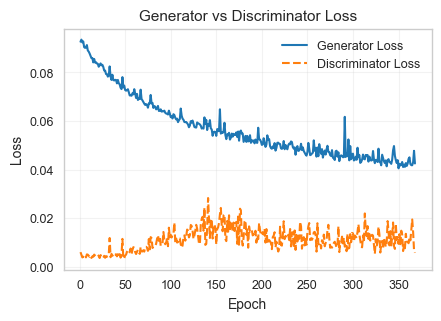

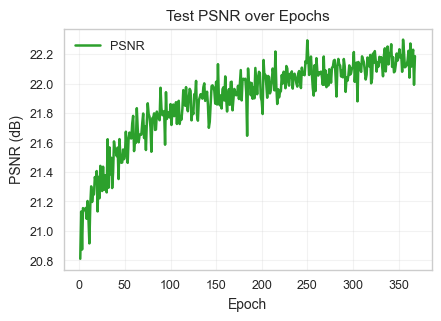

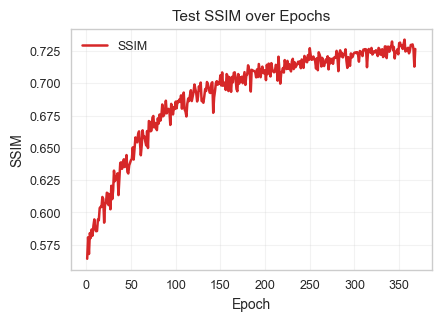

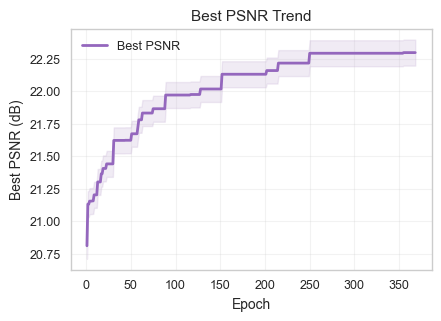

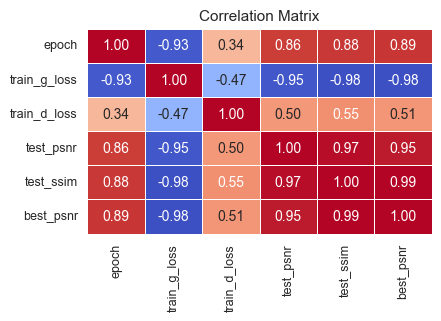

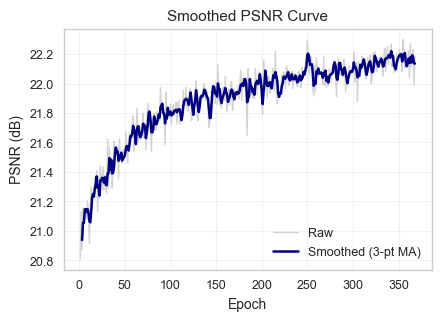

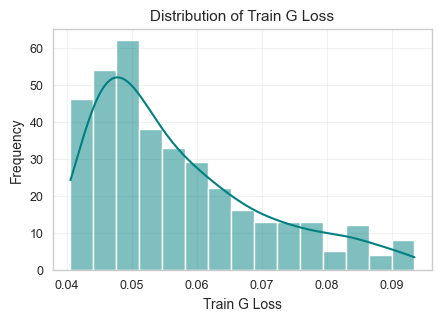

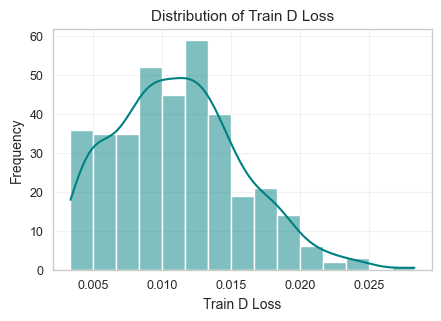

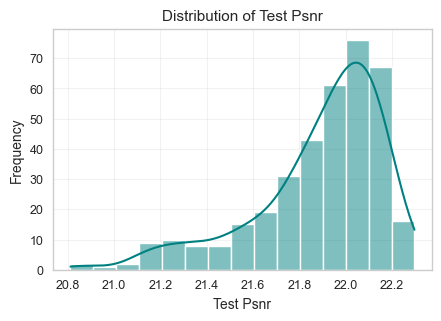

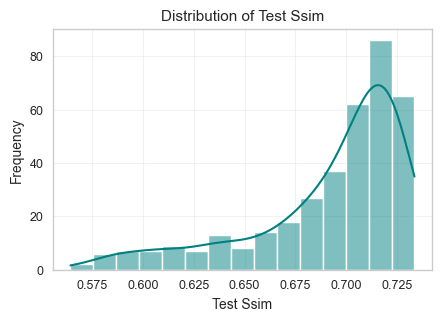


✅ All single-column research-grade plots saved successfully!


In [2]:
# ==============================================
# One-Column Research Paper Plots for GAN Metrics
# ==============================================

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams

# Load training log
df = pd.read_csv("training_log.csv")

# ==============================================
# ✨ Global Style Settings (Single-Column Format)
# ==============================================
rcParams.update({
    "font.family": "serif",
    "font.serif": ["Times New Roman"],
    "axes.labelsize": 10,
    "axes.titlesize": 11,
    "legend.fontsize": 9,
    "xtick.labelsize": 9,
    "ytick.labelsize": 9,
    "axes.linewidth": 1.0,
    "grid.alpha": 0.25,
    "grid.linestyle": "--",
    "savefig.dpi": 600,
    "figure.figsize": (4.3, 3.1),  # Ideal for one-column insertion
})
sns.set_style("whitegrid")
sns.set_palette("muted")

# ========== 1️⃣ Generator vs Discriminator Loss ==========
plt.figure()
plt.plot(df['epoch'], df['train_g_loss'], color="#1f77b4", linewidth=1.5, label="Generator Loss")
plt.plot(df['epoch'], df['train_d_loss'], color="#ff7f0e", linewidth=1.5, linestyle="--", label="Discriminator Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Generator vs Discriminator Loss")
plt.legend(frameon=False, loc="upper right")
plt.tight_layout(pad=0.3)
plt.savefig("col1_gan_loss_curve.png", bbox_inches='tight')
plt.show()

# ========== 2️⃣ PSNR Curve ==========
plt.figure()
plt.plot(df['epoch'], df['test_psnr'], color="#2ca02c", linewidth=1.8, label="PSNR")
plt.xlabel("Epoch")
plt.ylabel("PSNR (dB)")
plt.title("Test PSNR over Epochs")
plt.legend(frameon=False)
plt.tight_layout(pad=0.3)
plt.savefig("col2_psnr_curve.png", bbox_inches='tight')
plt.show()

# ========== 3️⃣ SSIM Curve ==========
plt.figure()
plt.plot(df['epoch'], df['test_ssim'], color="#d62728", linewidth=1.8, label="SSIM")
plt.xlabel("Epoch")
plt.ylabel("SSIM")
plt.title("Test SSIM over Epochs")
plt.legend(frameon=False)
plt.tight_layout(pad=0.3)
plt.savefig("col3_ssim_curve.png", bbox_inches='tight')
plt.show()

# ========== 4️⃣ Best PSNR Trend ==========
plt.figure()
plt.plot(df['epoch'], df['best_psnr'], color="#9467bd", linewidth=2, label="Best PSNR")
plt.fill_between(df['epoch'], df['best_psnr'] - 0.1, df['best_psnr'] + 0.1, color="#c5b0d5", alpha=0.25)
plt.xlabel("Epoch")
plt.ylabel("Best PSNR (dB)")
plt.title("Best PSNR Trend")
plt.legend(frameon=False)
plt.tight_layout(pad=0.3)
plt.savefig("col4_best_psnr.png", bbox_inches='tight')
plt.show()

# ========== 5️⃣ Correlation Heatmap ==========
plt.figure(figsize=(4.3, 3.1))
corr = df.corr(numeric_only=True)
sns.heatmap(corr, cmap='coolwarm', center=0, annot=True, fmt=".2f", linewidths=.5, cbar=False)
plt.title("Correlation Matrix")
plt.tight_layout(pad=0.3)
plt.savefig("col5_corr_heatmap.png", bbox_inches='tight')
plt.show()

# ========== 6️⃣ Smoothed PSNR Curve ==========
plt.figure()
window = 3
plt.plot(df['epoch'], df['test_psnr'], color='lightgray', linewidth=1.0, label="Raw")
plt.plot(df['epoch'], df['test_psnr'].rolling(window).mean(), color='navy', linewidth=1.8, label=f"Smoothed ({window}-pt MA)")
plt.xlabel("Epoch")
plt.ylabel("PSNR (dB)")
plt.title("Smoothed PSNR Curve")
plt.legend(frameon=False)
plt.tight_layout(pad=0.3)
plt.savefig("col6_smooth_psnr.png", bbox_inches='tight')
plt.show()

# ========== 7️⃣ Metric Distributions ==========
metrics = ['train_g_loss', 'train_d_loss', 'test_psnr', 'test_ssim']
for col in metrics:
    plt.figure()
    sns.histplot(df[col], kde=True, color='teal', bins=15)
    plt.xlabel(col.replace('_', ' ').title())
    plt.ylabel("Frequency")
    plt.title(f"Distribution of {col.replace('_', ' ').title()}")
    plt.tight_layout(pad=0.3)
    plt.savefig(f"col7_dist_{col}.png", bbox_inches='tight')
    plt.show()

print("\n✅ All single-column research-grade plots saved successfully!")
